__Importing required libraries__

In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = '3'
import imageio
import numpy as np
import pandas as pd
from PIL import Image
import random
import cv2
from skimage import io
from tqdm.auto import tqdm
from xml.etree import ElementTree
from matplotlib import pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid

import torch
import torchvision
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms.functional as TF
from torch.utils.data import Dataset, DataLoader, random_split
from torchvision import transforms
from torchsummary import summary

__Augmentation for face__

In [2]:
class FaceAugmentation:
    def __init__(self,
                 image_dim,
                 brightness,    
                 contrast,
                 saturation,
                 hue,
                 face_offset,
                 crop_offset):
        
        self.image_dim = image_dim
        self.face_offset = face_offset
        self.crop_offset = crop_offset
        self.transform = transforms.ColorJitter(brightness, contrast, saturation, hue)
    
    def offset_crop(self, image, landmarks, crops_coordinates):
        left = int(crops_coordinates[0]) - self.face_offset
        top = int(crops_coordinates[1]) - self.face_offset
        width = int(crops_coordinates[2]) + (2 * self.face_offset)
        height = int(crops_coordinates[3]) + (2 * self.face_offset)

        image = TF.crop(image, top, left, height, width)
        landmarks = landmarks - np.array([[left, top]])

        new_dim = self.image_dim + self.crop_offset

        image = TF.resize(image, (new_dim, new_dim))

        landmarks[:, 0] *= new_dim / width
        landmarks[:, 1] *= new_dim / height

        return image, landmarks
    
    def random_face_crop(self, image, landmarks):
        image = np.array(image)

        h, w = image.shape[:2]

        top = np.random.randint(0, h - self.image_dim)
        left = np.random.randint(0, w - self.image_dim)

        image = image[top: top + self.image_dim, left: left + self.image_dim]

        landmarks = landmarks - np.array([[left, top]])

        return TF.to_pil_image(image), landmarks
    
    def __call__(self, image, landmarks, crops_coordinates):
        image, landmarks = self.offset_crop(image, landmarks, crops_coordinates)

        image, landmarks = self.random_face_crop(image, landmarks)

        return self.transform(image), landmarks

__Augmentation for landmarks__

In [3]:
class LandmarksAugmentation:
    def __init__(self, rotation_limit):
        self.rotation_limit = rotation_limit

    def random_rotation(self, image, landmarks):
        angle = np.random.uniform(-self.rotation_limit, self.rotation_limit)
        landmarks_transformation = np.array([
            [+np.cos(np.radians(angle)), -np.sin(np.radians(angle))], 
            [+np.sin(np.radians(angle)), +np.cos(np.radians(angle))]
        ])
        image = TF.rotate(image, angle)
        landmarks = landmarks - 0.5
        transformed_landmarks = np.matmul(landmarks, landmarks_transformation)
        transformed_landmarks = transformed_landmarks + 0.5

        return image, transformed_landmarks
    
    def __call__(self, image, landmarks):
        image, landmarks = self.random_rotation(image, landmarks)
        return image, landmarks

__Data Preprocessing__

In [4]:
class Preprocessor:
    def __init__(self,
                 image_dim,
                 brightness,
                 contrast,
                 saturation,
                 hue,
                 angle,
                 face_offset,
                 crop_offset):
        
        self.image_dim = image_dim

        self.landmarks_augmentation = LandmarksAugmentation(angle)
        self.face_augmentation = FaceAugmentation(image_dim, brightness, contrast, saturation, hue, face_offset, crop_offset)
    
    def __call__(self, image, landmarks, crops_coordinates):
        image = TF.to_pil_image(image)

        image, landmarks = self.face_augmentation(image, landmarks, crops_coordinates)

        landmarks = landmarks / np.array([*image.size])

        image, landmarks = self.landmarks_augmentation(image, landmarks)
        
        image = TF.to_grayscale(image)

        image = TF.to_tensor(image)

        image = (image - image.min())/(image.max() - image.min())
        image = (2 * image) - 1

        return image, torch.FloatTensor(landmarks.reshape(-1) - 0.5)

__Creating the dataset class__

In [5]:
class LandmarksDataset(Dataset):
    def __init__(self, preprocessor, root_dir, types="train"):
        self.types = types
        self.root_dir = root_dir
        self.preprocessor = preprocessor
        self.data_root = pd.read_csv(self.root_dir).values.tolist()
        random.shuffle(self.data_root)
    def __len__(self):
        return len(self.data_root)

    def __getitem__(self, idx):
        data = self.data_root[idx]
        image = io.imread(data[2], as_gray = False)
        
        landmarks = []
        x_list = []
        y_list = []
        for point in data[10:]:
            x,y =  eval(point[1:-1])
            x_list.append(x)
            y_list.append(y)
            landmarks.append([x,y])
        x_min, x_max = np.min(x_list), np.max(x_list)
        y_min, y_max = np.min(y_list), np.max(y_list)
        landmarks = np.array(landmarks).astype(float)
        crops = [x_min, y_min, x_max-x_min, y_max-y_min]

        image, landmarks = self.preprocessor(image, landmarks, crops)
        return image, landmarks

__Some helper functions for visualizing the data__

In [6]:
def visualize_image(image, landmarks):
    plt.figure(figsize = (5, 5))
    image = (image - image.min())/(image.max() - image.min())

    landmarks = landmarks.view(-1, 2)
    landmarks = (landmarks + 0.5) * preprocessor.image_dim

    plt.imshow(image[0], cmap = 'gray')
    plt.scatter(landmarks[:, 0], landmarks[:, 1], s = 25, c = 'dodgerblue')
    plt.axis('off')
    plt.show()
    
def visualize_batch(images_list, landmarks_list, gt_list, size = 14, shape = (6, 6), title = None, save = None):
    fig = plt.figure(figsize = (size, size))
    grid = ImageGrid(fig, 111, nrows_ncols = shape, axes_pad = 0.08)
    for ax, image, landmarks, gt in zip(grid, images_list, landmarks_list, gt_list):
        image = (image - image.min())/(image.max() - image.min())
        landmarks = landmarks
        landmarks = landmarks.view(-1, 2)
        landmarks = (landmarks+0.5) * preprocessor.image_dim
        landmarks = landmarks.detach().numpy().tolist()
        landmarks = np.array([(x, y) for (x, y) in landmarks if 0 <= x and 0 <= y])

        gt = gt.view(-1, 2)
        gt = (gt+0.5) * preprocessor.image_dim
        gt = gt.numpy().tolist()
        gt = np.array([(x, y) for (x, y) in gt if 0 <= x  and 0 <= y])

        ax.imshow(image[0], cmap='gray')
        ax.scatter(landmarks[:, 0], landmarks[:, 1], s = 10, c = 'dodgerblue')
        ax.scatter(gt[:, 0], gt[:, 1], s = 10, c = 'red', marker='*')
        ax.axis('off')

    if title:
        print(title)
    if save:
        plt.savefig(save)
    plt.show()

__Initializing preprocessor, train and test images__

In [7]:
preprocessor = Preprocessor(
    image_dim = 128,
    brightness = 0.24,
    saturation = 0.3,
    contrast = 0.15,
    hue = 0.14,
    angle = 14,
    face_offset = 32,
    crop_offset = 16)

# train_images = LandmarksDataset(preprocessor, root_dir="/data/komedi/komedi/dataset/versioning/22-07-22-1200-train.csv", types="train")
train_images = LandmarksDataset(preprocessor, root_dir="/home/ubuntu/workspace/FLD-scratch/src/data/train_df.csv", types="train")
valid_images_aflw = LandmarksDataset(preprocessor, root_dir = "/home/ubuntu/workspace/FLD-scratch/src/data/valid_aflw_df.csv", types="valid")
valid_images_kface = LandmarksDataset(preprocessor, root_dir = "/home/ubuntu/workspace/FLD-scratch/src/data/valid_kface_df.csv", types="valid")

__Visualizing a sample image, with random augmentations__

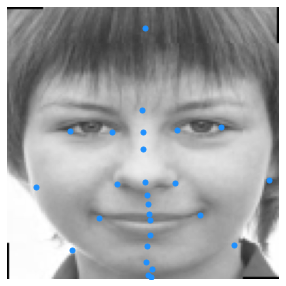

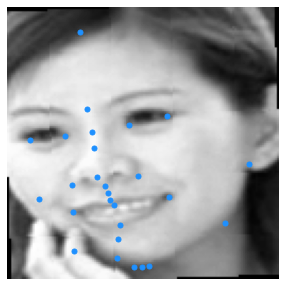

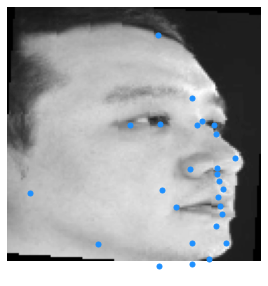

In [8]:
image1, landmarks1 = train_images[64]
visualize_image(image1, landmarks1)

image2, landmarks2 = valid_images_aflw[64]
visualize_image(image2, landmarks2)

image3, landmarks3 = valid_images_kface[64]
visualize_image(image3, landmarks3)

In [9]:
batch_size = 64
train_data = torch.utils.data.DataLoader(train_images, batch_size = batch_size, shuffle = True)
valid_data_aflw = torch.utils.data.DataLoader(valid_images_aflw, batch_size = batch_size, shuffle = False)
valid_data_kface = torch.utils.data.DataLoader(valid_images_kface, batch_size = batch_size, shuffle = False)

__Visualizing a sample batch__

In [10]:
for x, y in train_data:
    break

print(x.shape, y.shape, x.max(), x.min(), y.max(), y.min())

for x, y in valid_data_aflw:
    break

print(x.shape, y.shape, x.max(), x.min(), y.max(), y.min())

for x, y in valid_data_kface:
    break

print(x.shape, y.shape, x.max(), x.min(), y.max(), y.min())

torch.Size([64, 1, 128, 128]) torch.Size([64, 54]) tensor(1.) tensor(-1.) tensor(0.5080) tensor(-0.5308)
torch.Size([64, 1, 128, 128]) torch.Size([64, 54]) tensor(1.) tensor(-1.) tensor(0.5307) tensor(-0.5417)
torch.Size([64, 1, 128, 128]) torch.Size([64, 54]) tensor(1.) tensor(-1.) tensor(0.5283) tensor(-0.5283)


__Creating Xception Net model architecture__

In [11]:
class DepthewiseSeperableConv2d(nn.Module):
    def __init__(self, input_channels, output_channels, kernel_size, **kwargs):
        super(DepthewiseSeperableConv2d, self).__init__()

        self.depthwise = nn.Conv2d(input_channels, input_channels, kernel_size, groups = input_channels, bias = False, **kwargs)
        self.pointwise = nn.Conv2d(input_channels, output_channels, 1, bias = False)

    def forward(self, x):
        x = self.depthwise(x)
        x = self.pointwise(x)

        return x

In [12]:
class EntryBlock(nn.Module):
    def __init__(self):
        super(EntryBlock, self).__init__()

        self.conv1 = nn.Sequential(
            nn.Conv2d(1, 32, 3, padding = 1, bias = False),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2)
        )

        self.conv2 = nn.Sequential(
            nn.Conv2d(32, 64, 3, padding = 1, bias = False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2)
        )

        self.conv3_residual = nn.Sequential(
            DepthewiseSeperableConv2d(64, 64, 3, padding = 1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(64, 128, 3, padding = 1),
            nn.BatchNorm2d(128),
            nn.MaxPool2d(3, stride = 2, padding = 1),
        )

        self.conv3_direct = nn.Sequential(
            nn.Conv2d(64, 128, 1, stride = 2),
            nn.BatchNorm2d(128),
        )

        self.conv4_residual = nn.Sequential(
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(128, 128, 3, padding = 1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(128, 256, 3, padding = 1),
            nn.BatchNorm2d(256),
            nn.MaxPool2d(3, stride = 2, padding = 1)
        )

        self.conv4_direct = nn.Sequential(
            nn.Conv2d(128, 256, 1, stride = 2),
            nn.BatchNorm2d(256),
        )

    def forward(self, x):
        x = self.conv1(x)
        x = self.conv2(x)

        residual = self.conv3_residual(x)
        direct = self.conv3_direct(x)
        x = residual + direct
        
        residual = self.conv4_residual(x)
        direct = self.conv4_direct(x)
        x = residual + direct

        return x

In [13]:
class MiddleBasicBlock(nn.Module):
    def __init__(self):
        super(MiddleBasicBlock, self).__init__()

        self.conv1 = nn.Sequential(
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(256, 256, 3, padding = 1),
            nn.BatchNorm2d(256)
        )
        self.conv2 = nn.Sequential(
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(256, 256, 3, padding = 1),
            nn.BatchNorm2d(256)
        )
        self.conv3 = nn.Sequential(
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(256, 256, 3, padding = 1),
            nn.BatchNorm2d(256)
        )

    def forward(self, x):
        residual = self.conv1(x)
        residual = self.conv2(residual)
        residual = self.conv3(residual)

        return x + residual


class MiddleBlock(nn.Module):
    def __init__(self, num_blocks):
        super().__init__()

        self.block = nn.Sequential(*[MiddleBasicBlock() for _ in range(num_blocks)])

    def forward(self, x):
        x = self.block(x)

        return x

In [14]:
class ExitBlock(nn.Module):
    def __init__(self):
        super(ExitBlock, self).__init__()

        self.residual = nn.Sequential(
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(256, 256, 3, padding = 1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(256, 512, 3, padding = 1),
            nn.BatchNorm2d(512),
            nn.MaxPool2d(3, stride = 2, padding = 1)
        )

        self.direct = nn.Sequential(
            nn.Conv2d(256, 512, 1, stride = 2),
            nn.BatchNorm2d(512)
        )

        self.conv = nn.Sequential(
            DepthewiseSeperableConv2d(512, 512, 3, padding = 1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2),
            DepthewiseSeperableConv2d(512, 1024, 3, padding = 1),
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(0.2)
        )

        self.dropout = nn.Dropout(0.3)

        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))

    def forward(self, x):
        direct = self.direct(x)
        residual = self.residual(x)
        x = direct + residual
        
        x = self.conv(x)
        x = self.avgpool(x)
        x = self.dropout(x)

        return x

__Initializing the Xception Net model__

In [15]:
class XceptionNet(nn.Module):
    def __init__(self, num_middle_blocks = 6):
        super(XceptionNet, self).__init__()

        self.entry_block = EntryBlock()
        self.middel_block = MiddleBlock(num_middle_blocks)
        self.exit_block = ExitBlock()

        self.fc = nn.Linear(1024, 54)

    def forward(self, x):
        x = self.entry_block(x)
        x = self.middel_block(x)
        x = self.exit_block(x)

        x = x.view(x.size(0), -1)
        
        x = self.fc(x)

        return x

In [16]:
model = XceptionNet()
model.load_state_dict(torch.load("/data/komedi/tools/visualization/src/pretrained/xception/model-07-28-22-00.pt", map_location = 'cpu'))
model = model.cuda()

__Initializing the objective loss and optimizer__

In [17]:
objective = torch.nn.MSELoss(reduce=None)
optimizer = optim.Adam(model.parameters(), lr = 0.0008)

In [18]:
import numpy as np
from math import *
def NME(label_pd, label_gt):
    nme_list = []
    
    for i in range(label_gt.shape[0]):
        
        landmarks_gt = label_gt[i].view(-1,2)
        landmarks_gt = (landmarks_gt+0.5) * 128
        landmarks_gt = landmarks_gt.detach().cpu().numpy()
        
        landmarks_pv = label_pd[i].view(-1,2)
        landmarks_pv = (landmarks_pv+0.5) * 128
        landmarks_pv = landmarks_pv.detach().cpu().numpy()
        
        minx, maxx = np.min(landmarks_gt[0,:]), np.max(landmarks_gt[0,:])
        miny, maxy = np.min(landmarks_gt[1,:]), np.max(landmarks_gt[1,:])
        llength = sqrt((maxx - minx) * (maxy - miny))
        # 
        # length_list.append(llength)
        for idx in range(len(landmarks_gt)):
            dis = landmarks_pv[idx] - landmarks_gt[idx]
            dis = np.sqrt(np.sum(np.power(dis,2),0))
            nme = dis/llength
            nme_list.append(nme)

    nme_list = np.array(nme_list, dtype=np.float32)
    mean_nme = np.mean(nme_list)*100
    return mean_nme

__Defining validation function__

Validating:   0%|                                                                                             …

Validation sample predictions


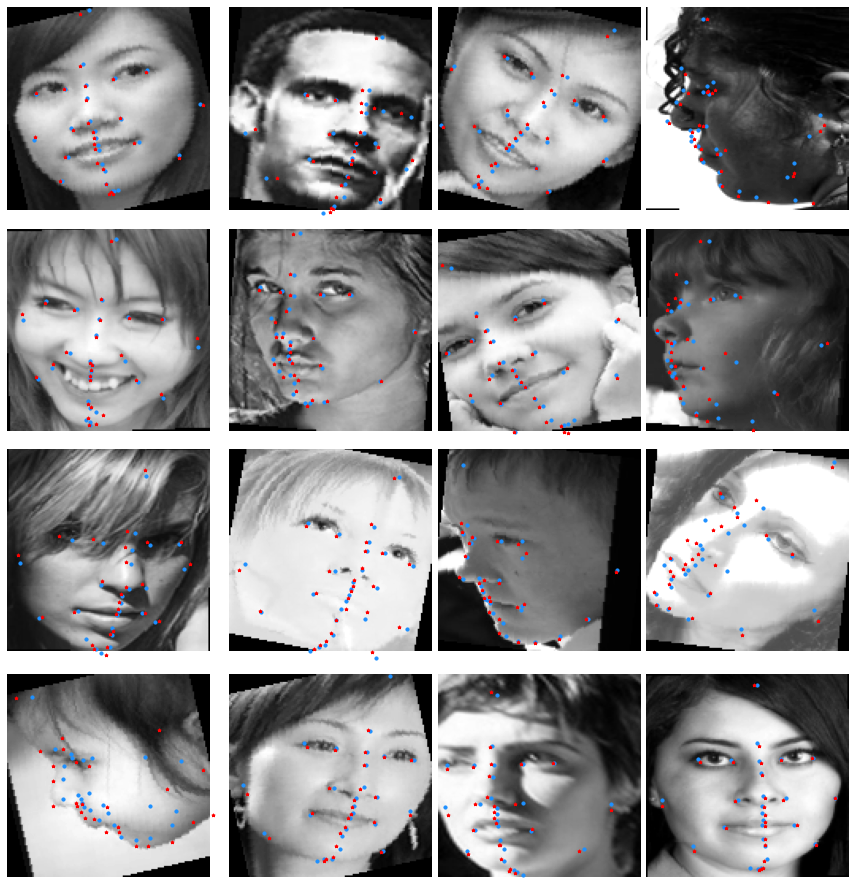

Validating:   0%|                                                                                             …

Validation sample predictions


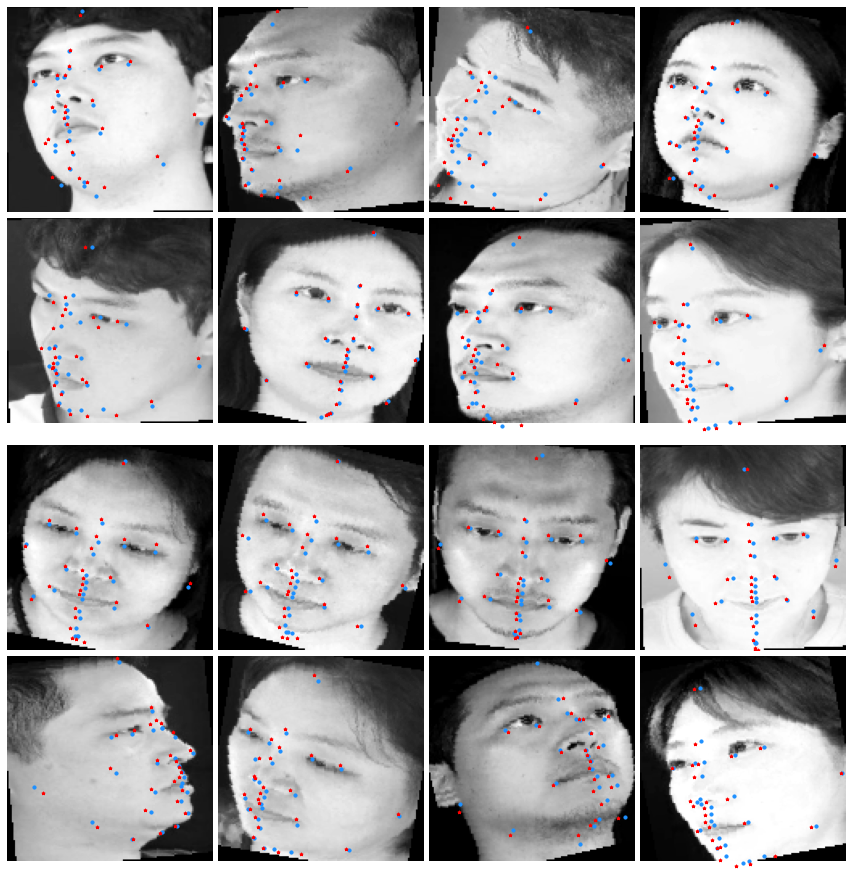

5.371715607387679e-05 0.7921457290649414
5.999662763705211e-05 0.968866901738303


In [19]:
@torch.no_grad()
def validate(val_data, save = None):
    cum_loss = 0.0
    cum_nme = 0.0
    model.eval()

    for features, labels in tqdm(val_data, desc = 'Validating', ncols = 600):
        features = features.cuda()
        labels = labels.cuda()

        outputs = model(features)

        loss = objective(outputs, labels)
        nme=NME(outputs, labels)
        
        cum_nme += nme.item()
        cum_loss += loss.item()

        break
    
            
    visualize_batch(features[:16].cpu(), outputs[:16].cpu(), labels[:16].cpu(), shape = (4, 4), size = 16, title = 'Validation sample predictions', save = save)

    return cum_loss/len(val_data), cum_nme/len(val_data)

aflw_loss, aflw_nme = validate(val_data=valid_data_aflw)
kface_loss, kface_nme = validate(val_data=valid_data_kface)
print(aflw_loss, aflw_nme)
print(kface_loss, kface_nme)

__Creating directory for storing the model's progress__

In [20]:
from datetime import date

In [21]:
dates = date.today().isoformat()
cases = "xception_01_00"
os.makedirs(f"/data/komedi/komedi/logs/{dates}/{cases}/image_logs/kface",exist_ok=True)
os.makedirs(f"/data/komedi/komedi/logs/{dates}/{cases}/image_logs/aflw",exist_ok=True)
os.makedirs(f"/data/komedi/komedi/logs/{dates}/{cases}/model_logs",exist_ok=True)

__training the model__

Epoch(1/100):   0%|                                                                                           …

0.00025954


Validating:   0%|                                                                                             …

Validation sample predictions


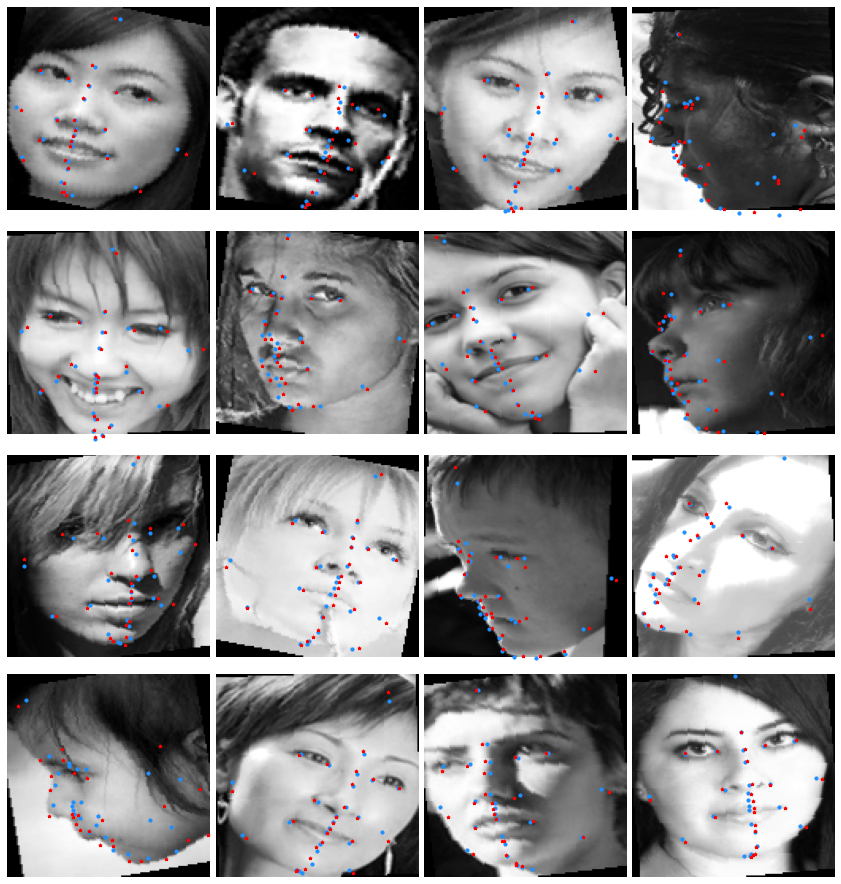

Validating:   0%|                                                                                             …

Validation sample predictions


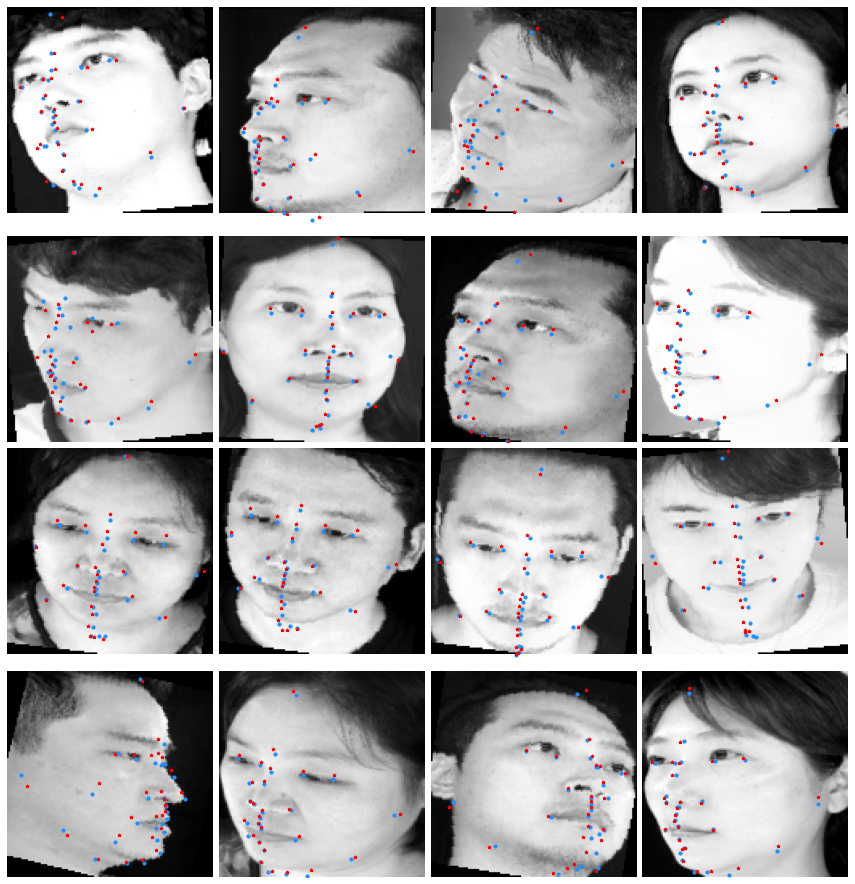

aflw nme: 0.8992 | kface nme: 0.8829
Saving model....................
Epoch(1/100) -> Training Loss: 0.00025954 | Validation Loss: 0.00005922 | Validation nme: 0.8912


Epoch(2/100):   0%|                                                                                           …

0.00022048


Epoch(3/100):   0%|                                                                                           …

0.00022068


Epoch(4/100):   0%|                                                                                           …

0.00021782


Epoch(5/100):   0%|                                                                                           …

0.00021283


Epoch(6/100):   0%|                                                                                           …

0.00034830


Validating:   0%|                                                                                             …

Validation sample predictions


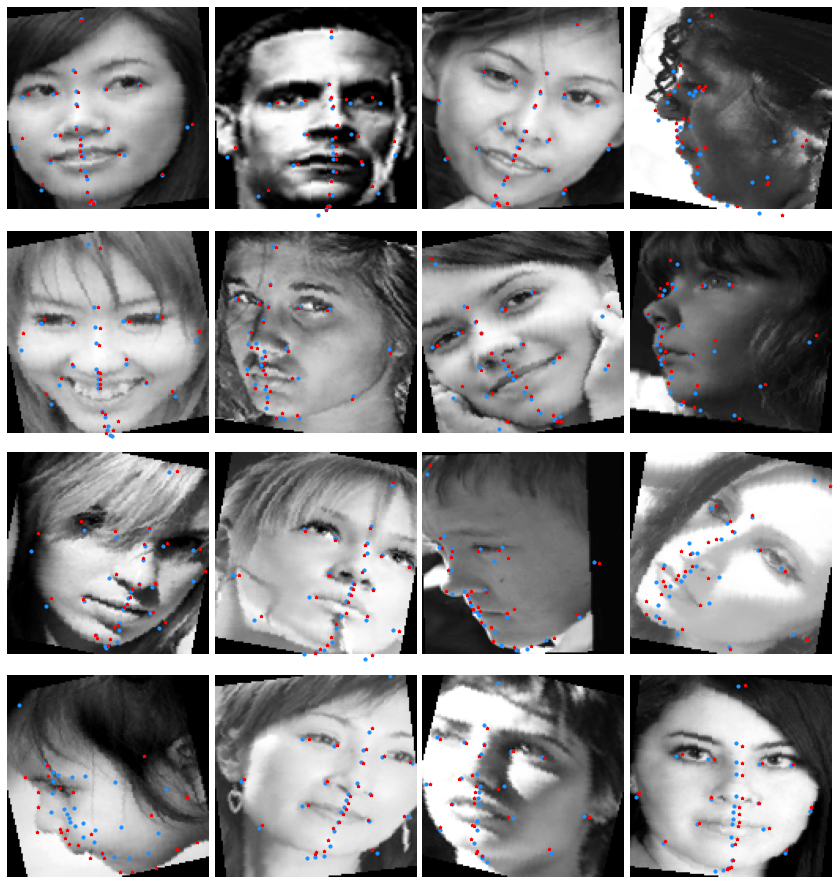

Validating:   0%|                                                                                             …

Validation sample predictions


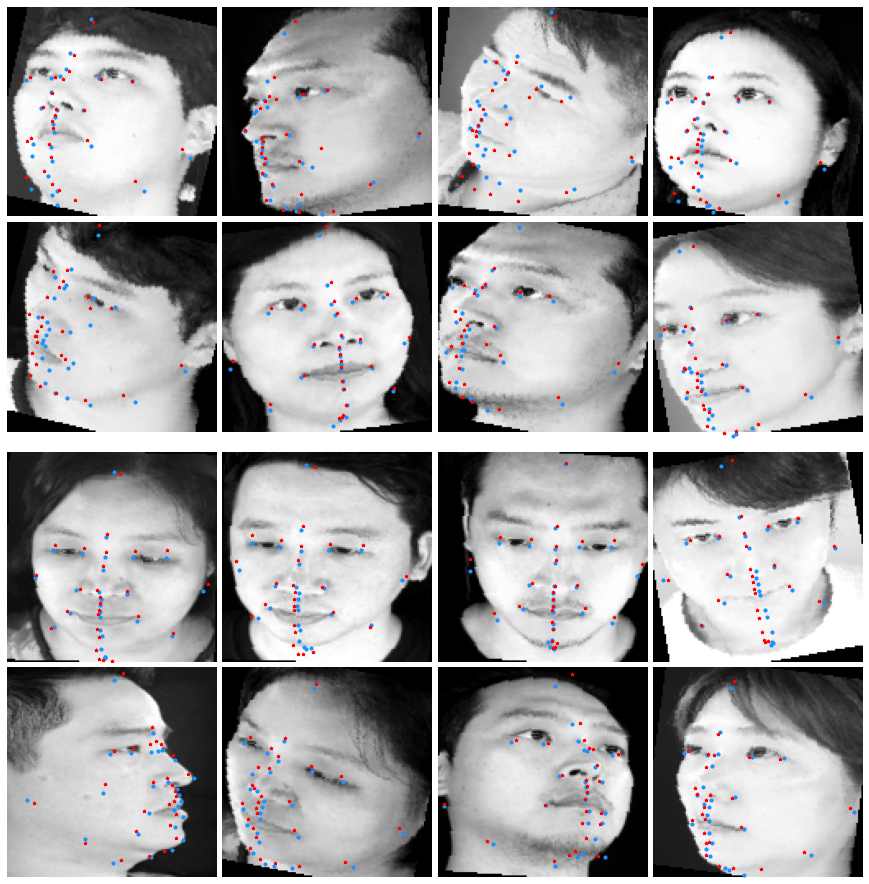

aflw nme: 1.1967 | kface nme: 1.2492
Epoch(6/100) -> Training Loss: 0.00034830 | Validation Loss: 0.00007531 | Validation nme: 0.8912


Epoch(7/100):   0%|                                                                                           …

0.00021993


Epoch(8/100):   0%|                                                                                           …

0.00019900


Epoch(9/100):   0%|                                                                                           …

0.00018871


Epoch(10/100):   0%|                                                                                          …

0.00018576


Epoch(11/100):   0%|                                                                                          …

0.00018395


Validating:   0%|                                                                                             …

Validation sample predictions


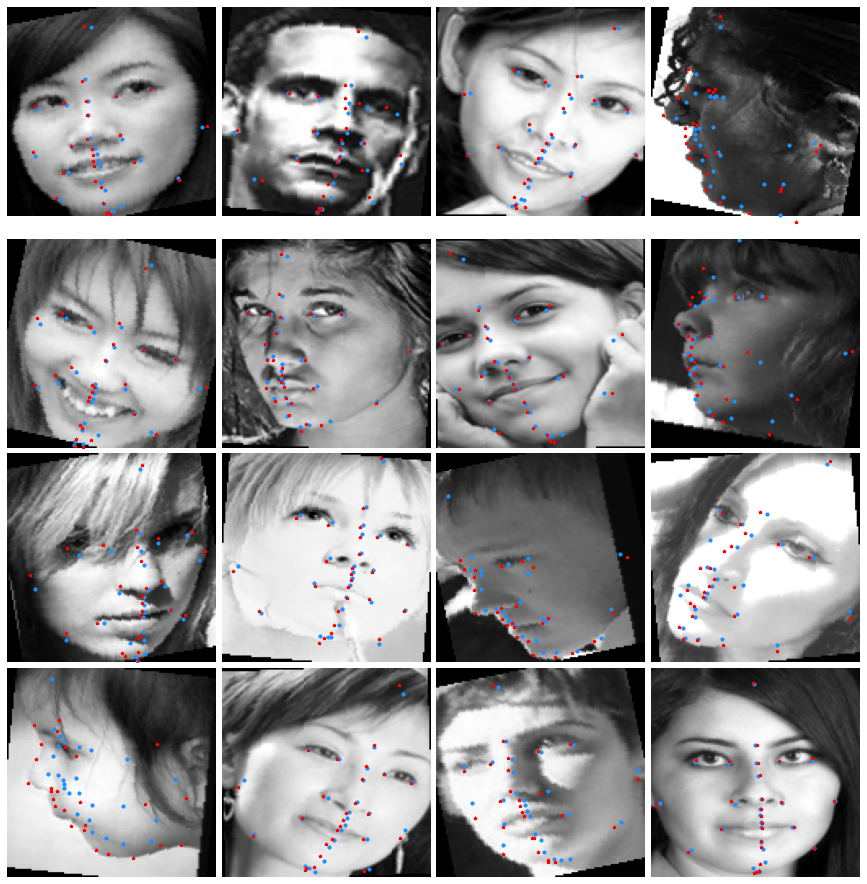

Validating:   0%|                                                                                             …

Validation sample predictions


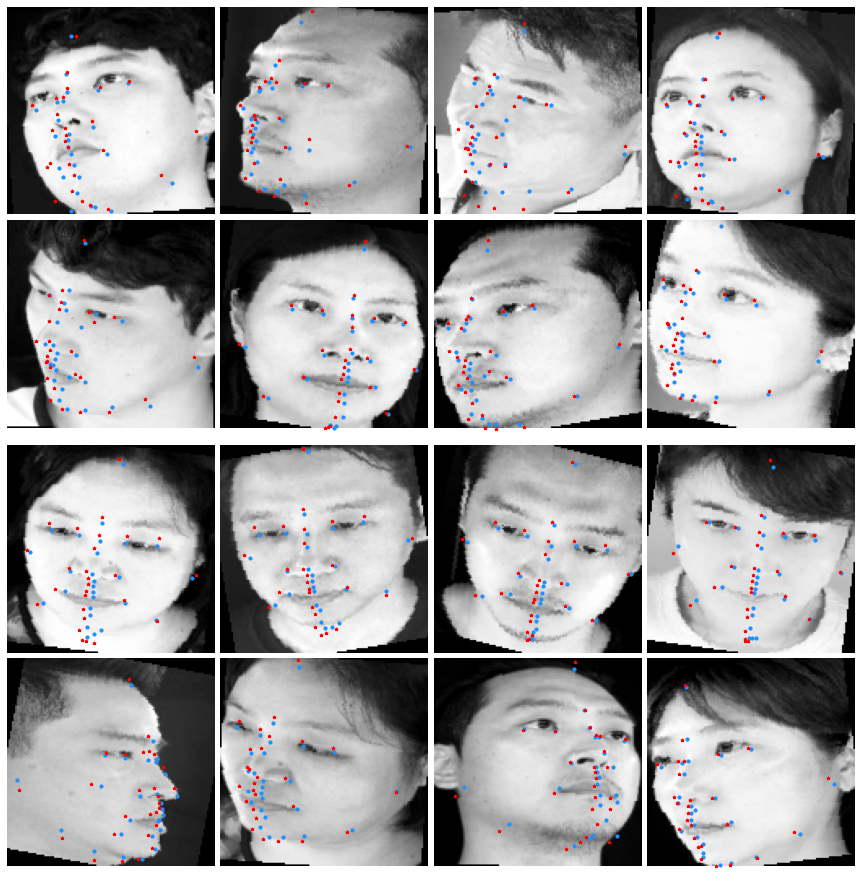

aflw nme: 1.1625 | kface nme: 0.9838
Epoch(11/100) -> Training Loss: 0.00018395 | Validation Loss: 0.00006931 | Validation nme: 0.8912


Epoch(12/100):   0%|                                                                                          …

0.00017451


Epoch(13/100):   0%|                                                                                          …

0.00017807


Epoch(14/100):   0%|                                                                                          …

0.00017693


Epoch(15/100):   0%|                                                                                          …

0.00017719


Epoch(16/100):   0%|                                                                                          …

0.00019337


Validating:   0%|                                                                                             …

Validation sample predictions


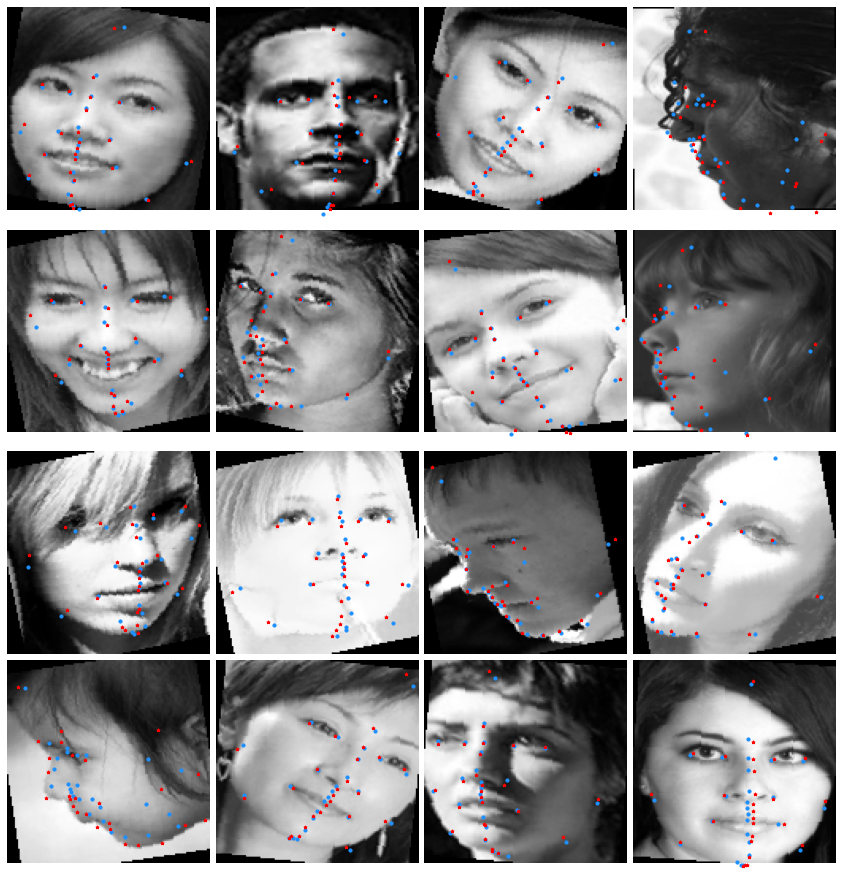

Validating:   0%|                                                                                             …

Validation sample predictions


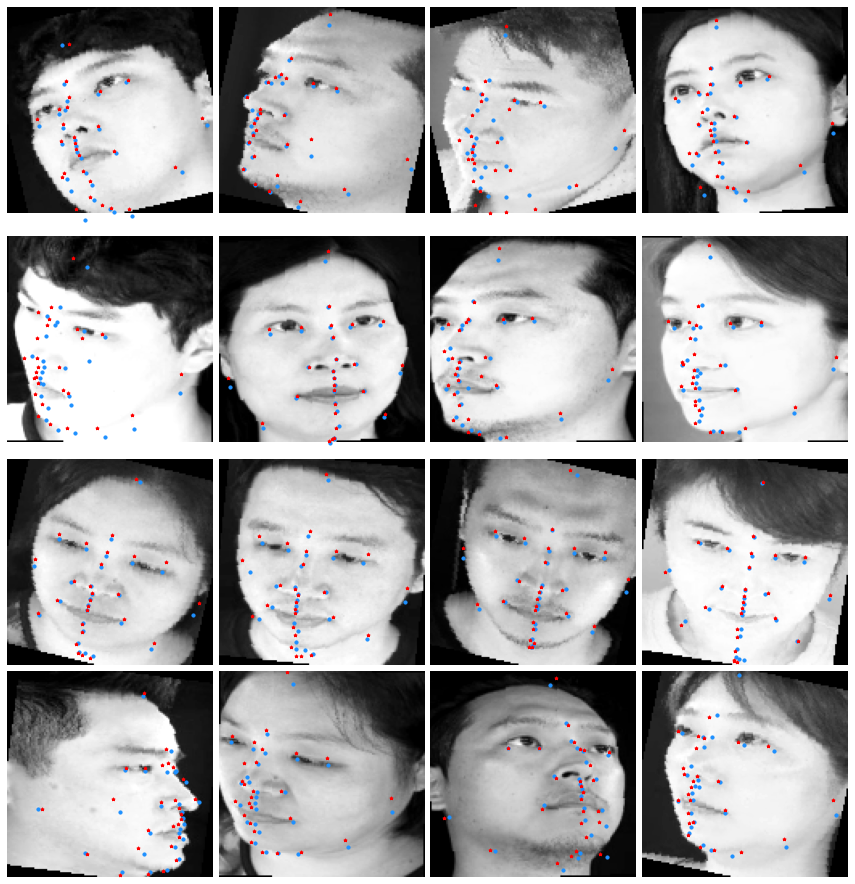

aflw nme: 0.9044 | kface nme: 1.1243
Epoch(16/100) -> Training Loss: 0.00019337 | Validation Loss: 0.00006678 | Validation nme: 0.8912


Epoch(17/100):   0%|                                                                                          …

0.00017592


Epoch(18/100):   0%|                                                                                          …

0.00016973


Epoch(19/100):   0%|                                                                                          …

0.00016838


Epoch(20/100):   0%|                                                                                          …

0.00016958


Epoch(21/100):   0%|                                                                                          …

0.00017112


Validating:   0%|                                                                                             …

Validation sample predictions


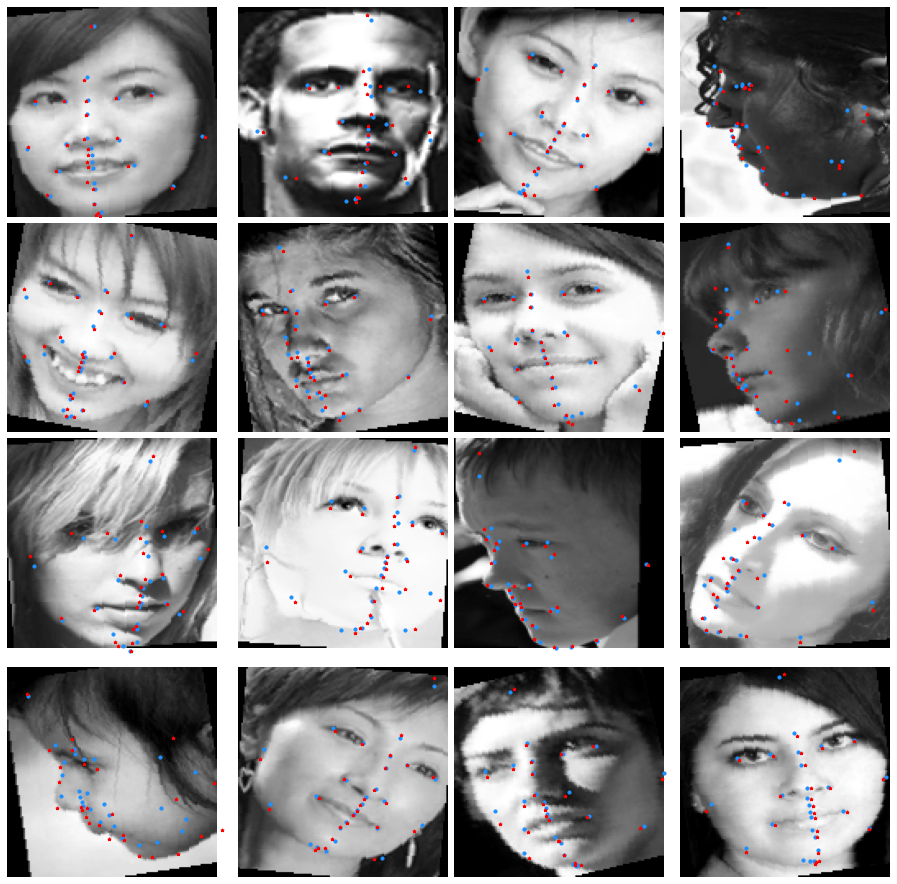

Validating:   0%|                                                                                             …

Validation sample predictions


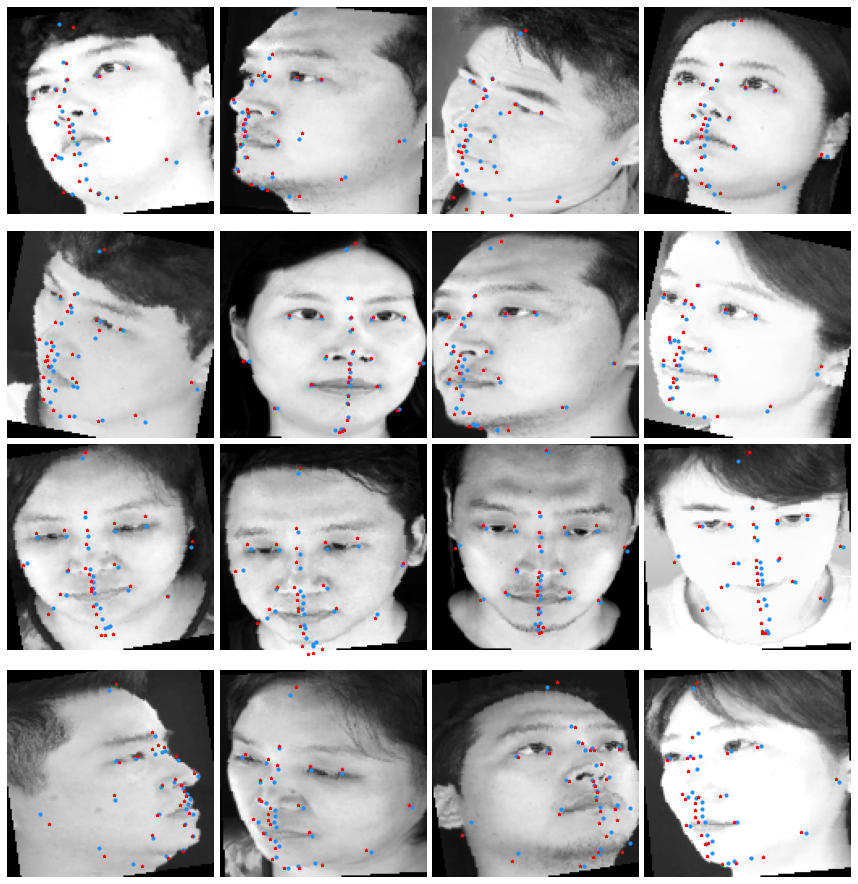

aflw nme: 0.8376 | kface nme: 1.0087
Epoch(21/100) -> Training Loss: 0.00017112 | Validation Loss: 0.00005968 | Validation nme: 0.8912


Epoch(22/100):   0%|                                                                                          …

0.00017684


Epoch(23/100):   0%|                                                                                          …

0.00017168


Epoch(24/100):   0%|                                                                                          …

0.00019113


Epoch(25/100):   0%|                                                                                          …

0.00017187


Epoch(26/100):   0%|                                                                                          …

0.00017682


Validating:   0%|                                                                                             …

Validation sample predictions


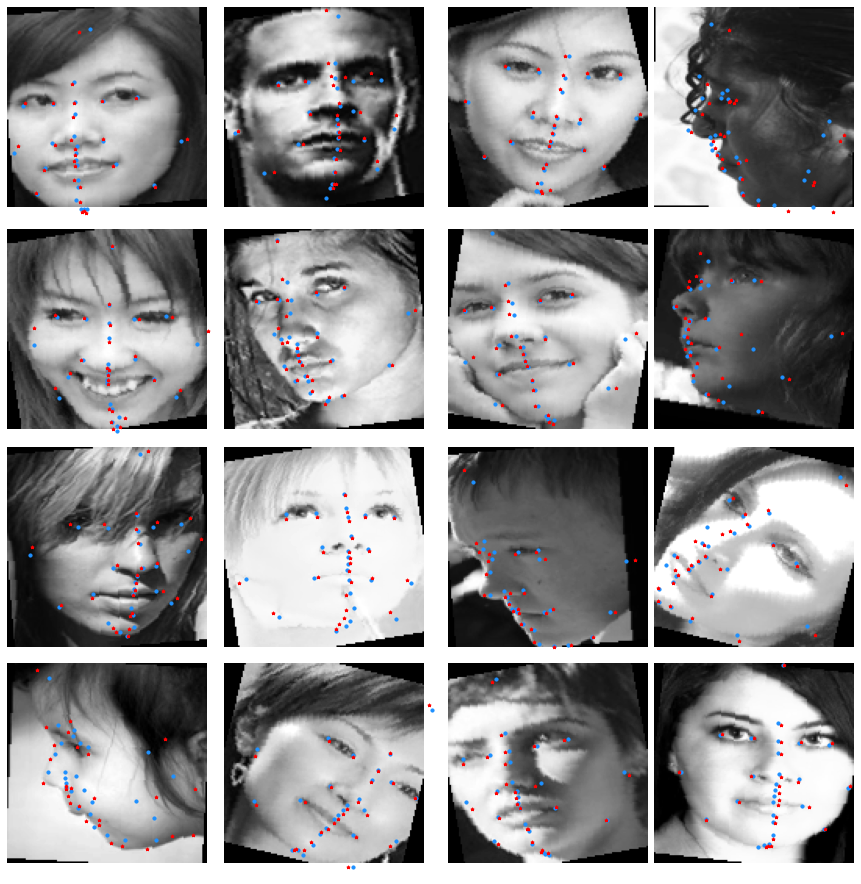

Validating:   0%|                                                                                             …

Validation sample predictions


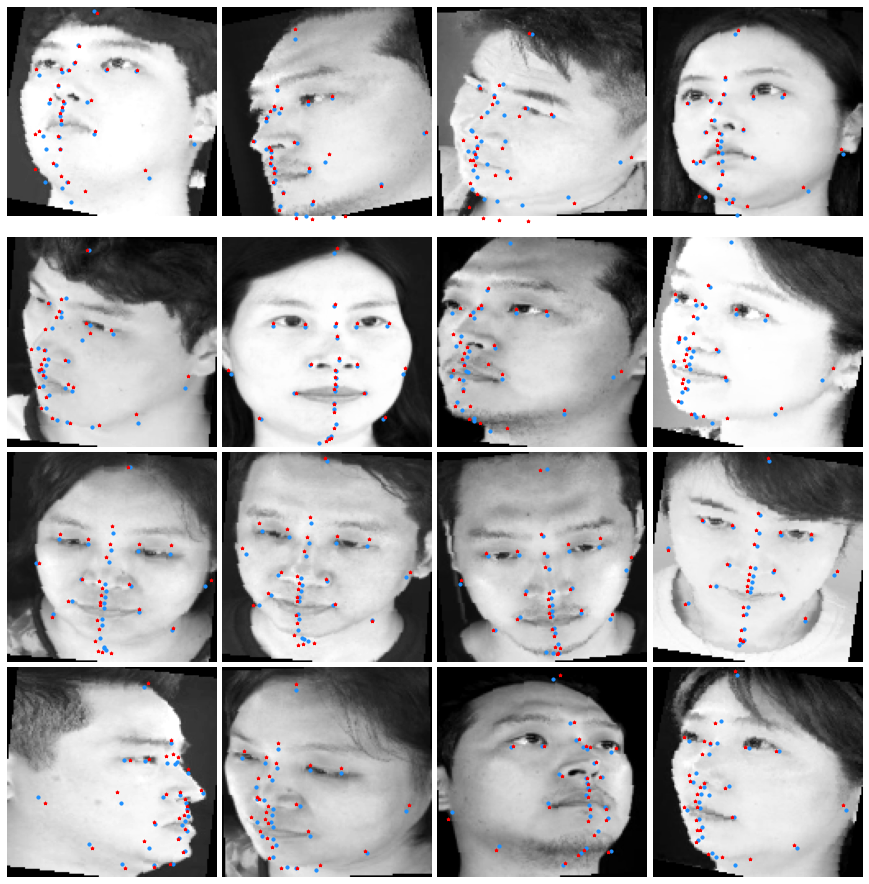

aflw nme: 0.8541 | kface nme: 0.8885
Saving model....................
Epoch(26/100) -> Training Loss: 0.00017682 | Validation Loss: 0.00005834 | Validation nme: 0.8711


Epoch(27/100):   0%|                                                                                          …

0.00017264


Epoch(28/100):   0%|                                                                                          …

0.00016801


Epoch(29/100):   0%|                                                                                          …

0.00017152


Epoch(30/100):   0%|                                                                                          …

0.00017410


Epoch(31/100):   0%|                                                                                          …

0.00017384


Validating:   0%|                                                                                             …

Validation sample predictions


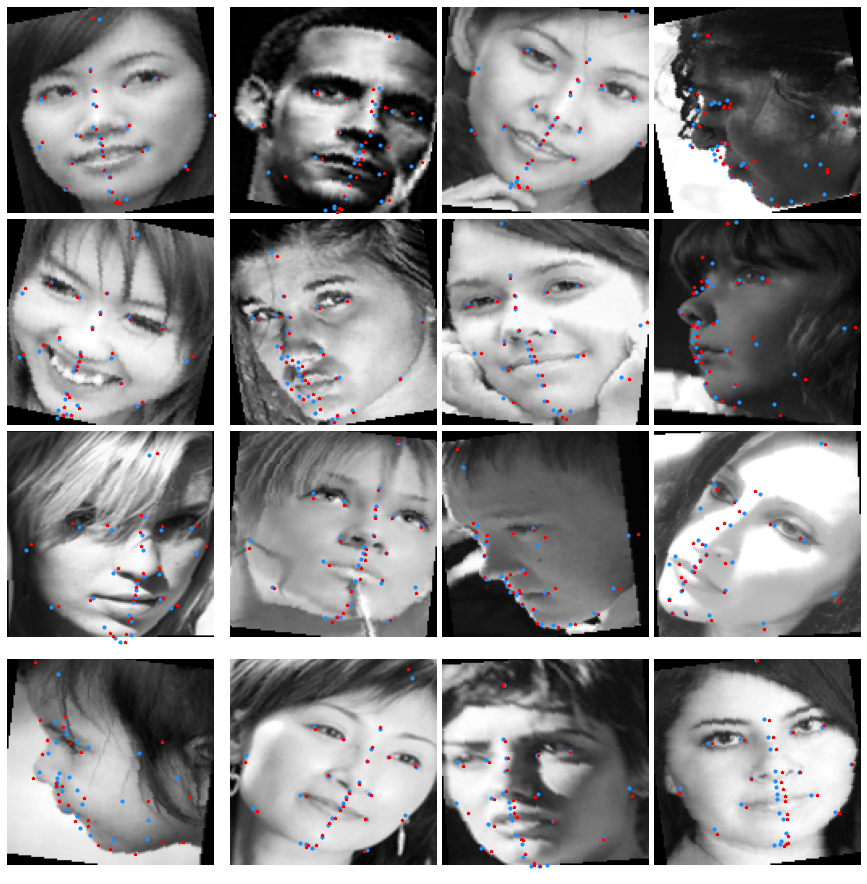

Validating:   0%|                                                                                             …

Validation sample predictions


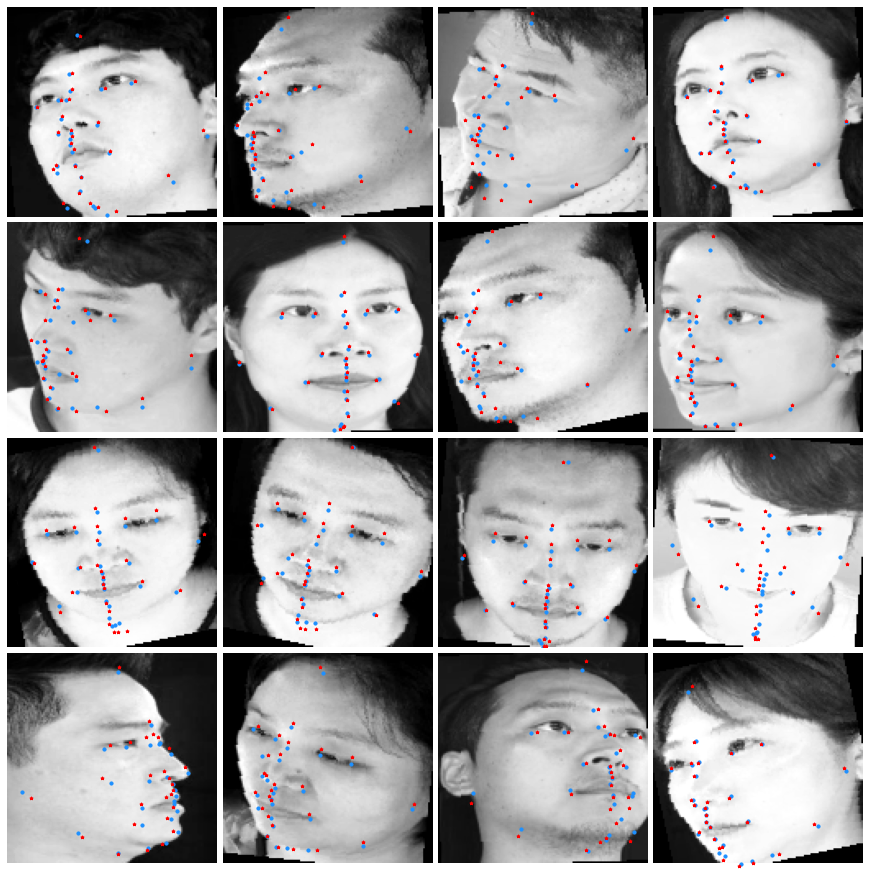

aflw nme: 1.2606 | kface nme: 0.8941
Epoch(31/100) -> Training Loss: 0.00017384 | Validation Loss: 0.00006008 | Validation nme: 0.8711


Epoch(32/100):   0%|                                                                                          …

0.00015940


Epoch(33/100):   0%|                                                                                          …

0.00016468


Epoch(34/100):   0%|                                                                                          …

0.00016551


Epoch(35/100):   0%|                                                                                          …

0.00017437


Epoch(36/100):   0%|                                                                                          …

0.00016532


Validating:   0%|                                                                                             …

Validation sample predictions


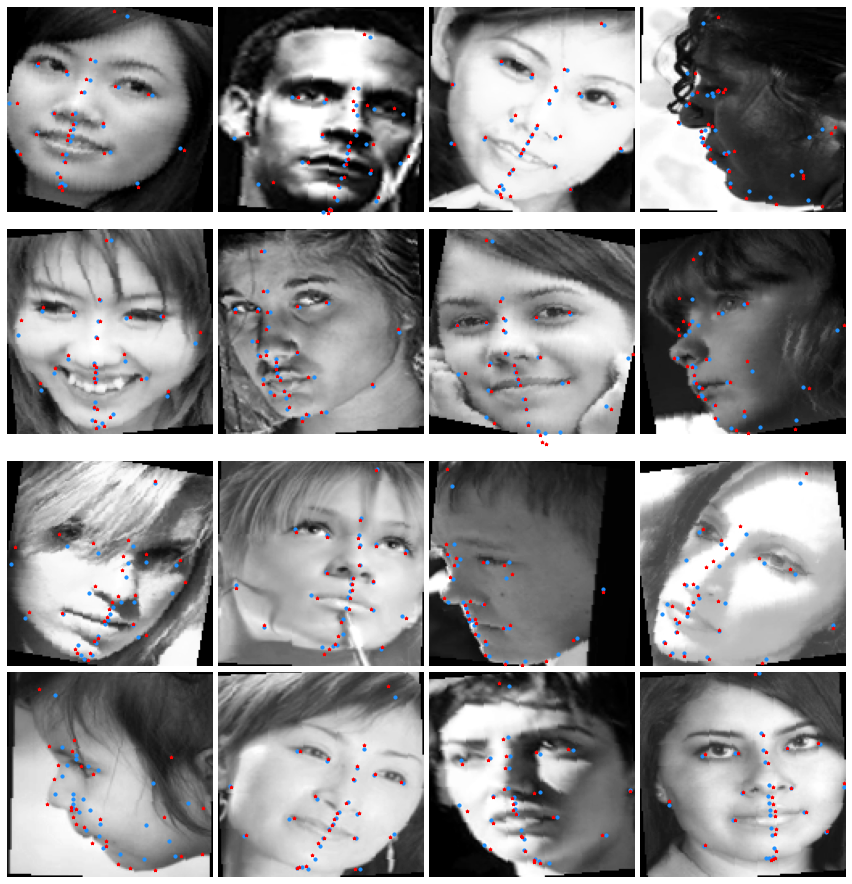

Validating:   0%|                                                                                             …

Validation sample predictions


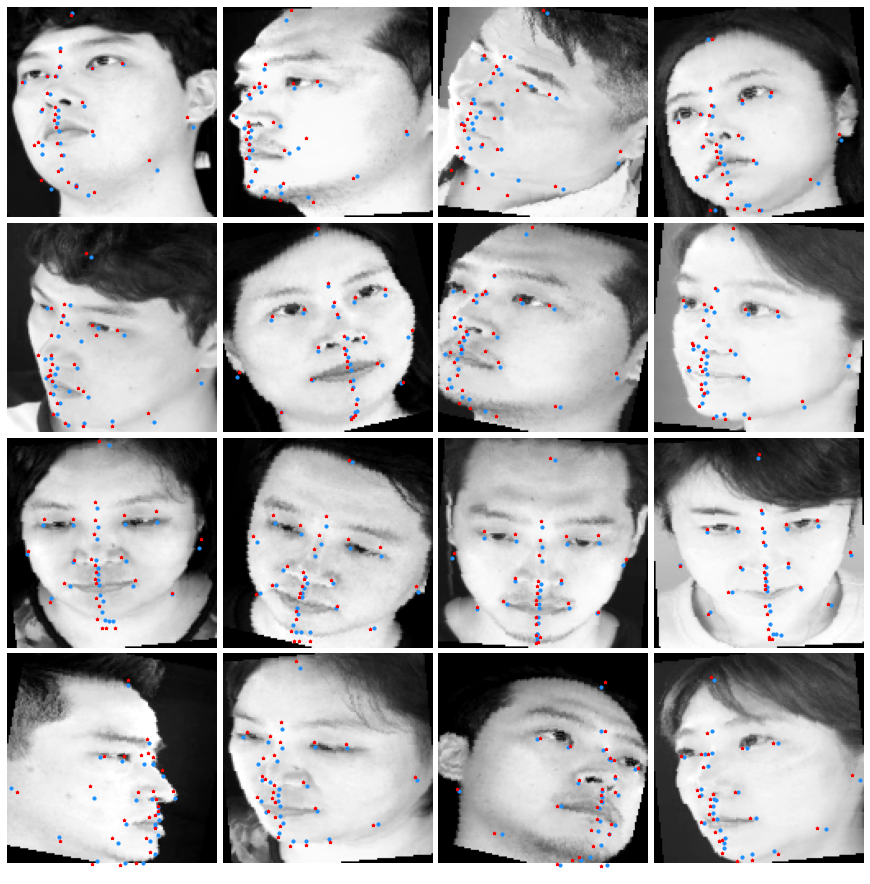

aflw nme: 0.8648 | kface nme: 1.1201
Epoch(36/100) -> Training Loss: 0.00016532 | Validation Loss: 0.00006361 | Validation nme: 0.8711


Epoch(37/100):   0%|                                                                                          …

0.00017415


Epoch(38/100):   0%|                                                                                          …

0.00017412


Epoch(39/100):   0%|                                                                                          …

0.00023366


Epoch(40/100):   0%|                                                                                          …

0.00020123


Epoch(41/100):   0%|                                                                                          …

0.00017383


Validating:   0%|                                                                                             …

Validation sample predictions


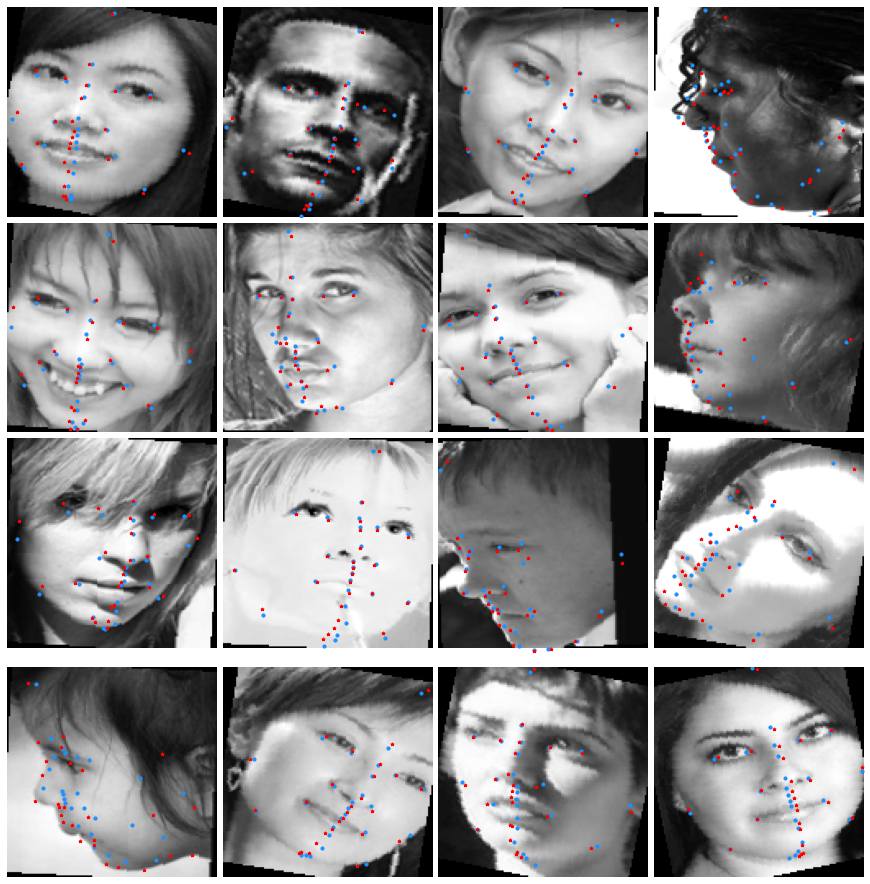

Validating:   0%|                                                                                             …

Validation sample predictions


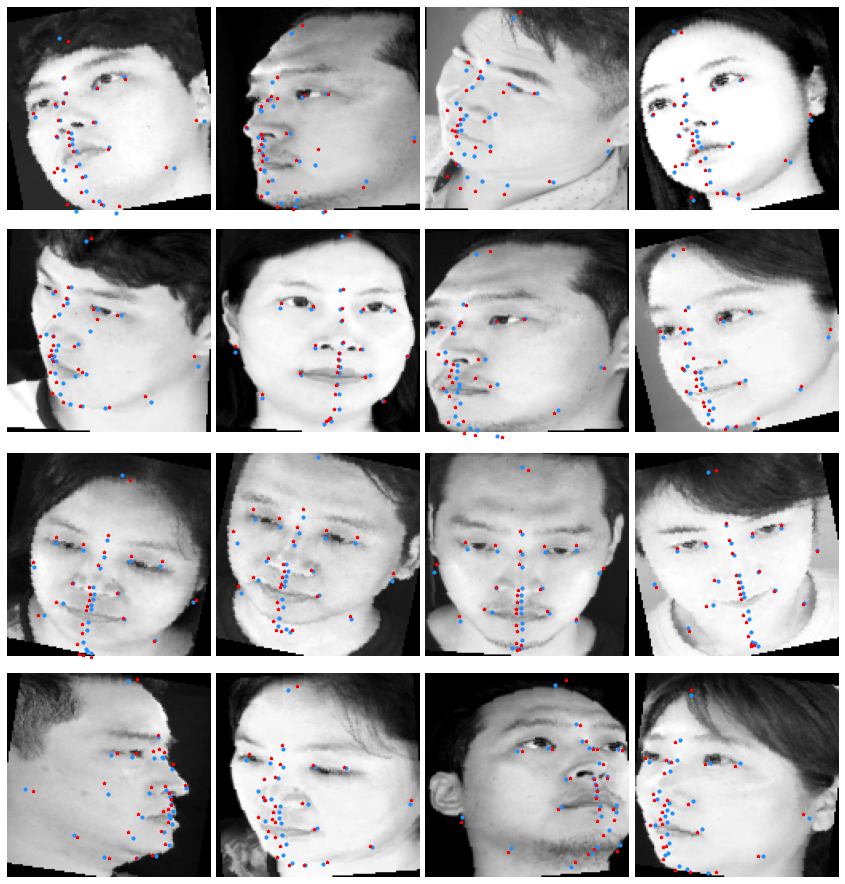

aflw nme: 1.1064 | kface nme: 1.0970
Epoch(41/100) -> Training Loss: 0.00017383 | Validation Loss: 0.00006533 | Validation nme: 0.8711


Epoch(42/100):   0%|                                                                                          …

0.00018126


Epoch(43/100):   0%|                                                                                          …

0.00016800


Epoch(44/100):   0%|                                                                                          …

0.00016388


Epoch(45/100):   0%|                                                                                          …

0.00015597


Epoch(46/100):   0%|                                                                                          …

0.00015619


Validating:   0%|                                                                                             …

Validation sample predictions


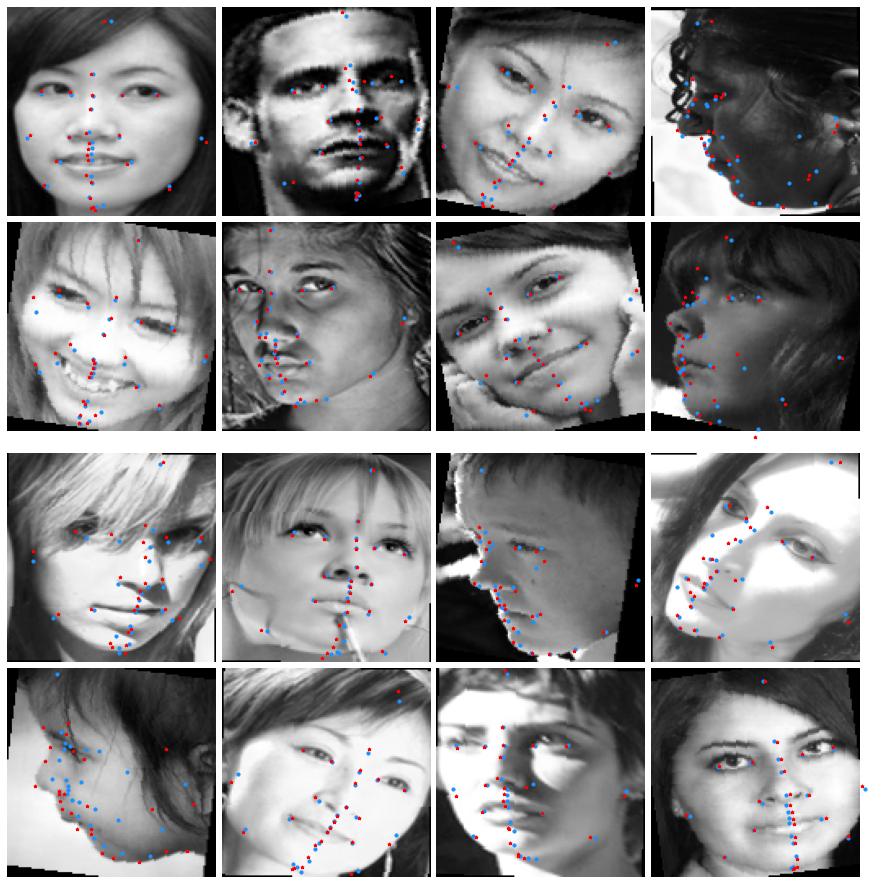

Validating:   0%|                                                                                             …

Validation sample predictions


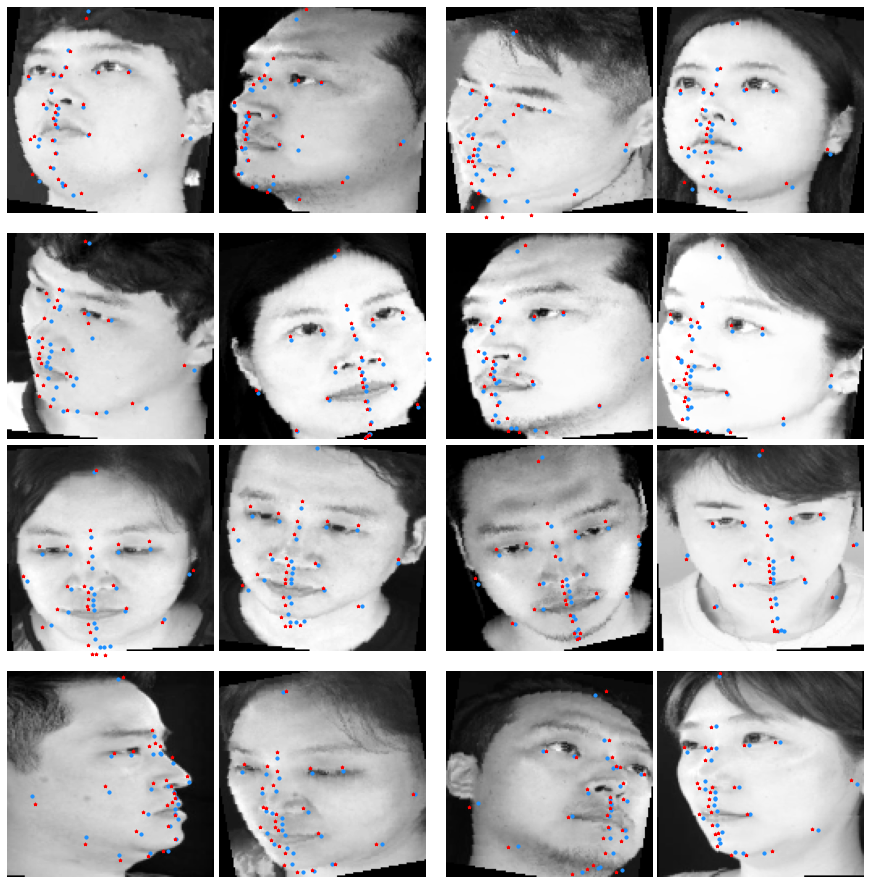

aflw nme: 1.3645 | kface nme: 0.9735
Epoch(46/100) -> Training Loss: 0.00015619 | Validation Loss: 0.00006875 | Validation nme: 0.8711


Epoch(47/100):   0%|                                                                                          …

0.00018059


Epoch(48/100):   0%|                                                                                          …

0.00015880


Epoch(49/100):   0%|                                                                                          …

0.00015060


Epoch(50/100):   0%|                                                                                          …

0.00015184


Epoch(51/100):   0%|                                                                                          …

0.00016982


Validating:   0%|                                                                                             …

Validation sample predictions


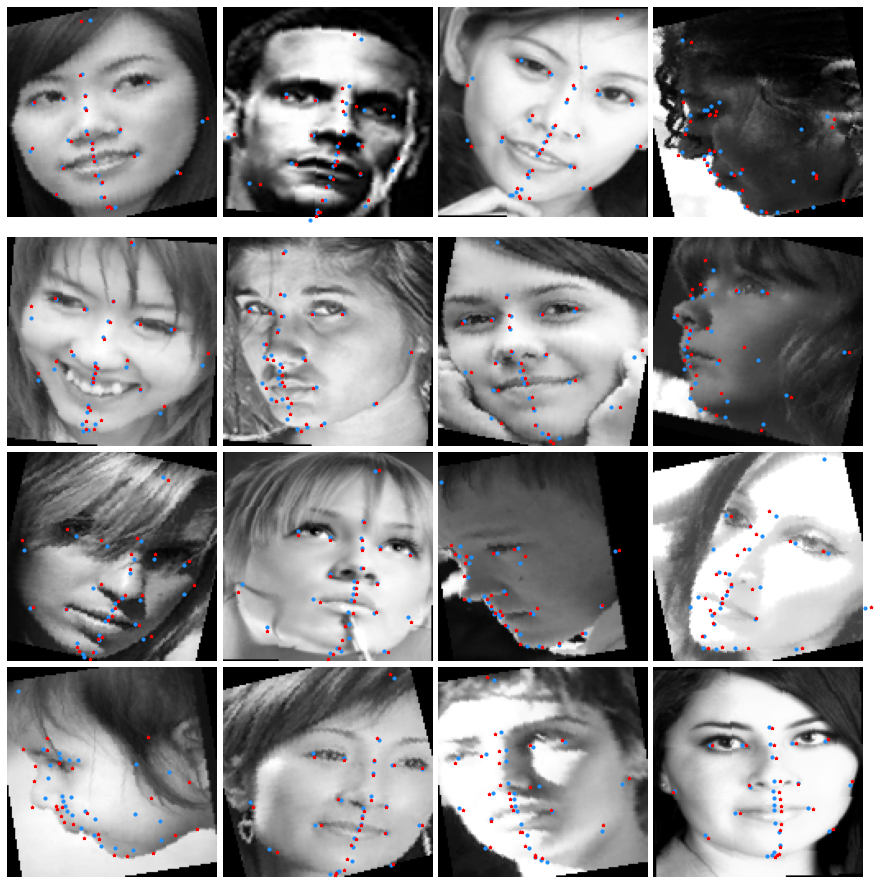

Validating:   0%|                                                                                             …

Validation sample predictions


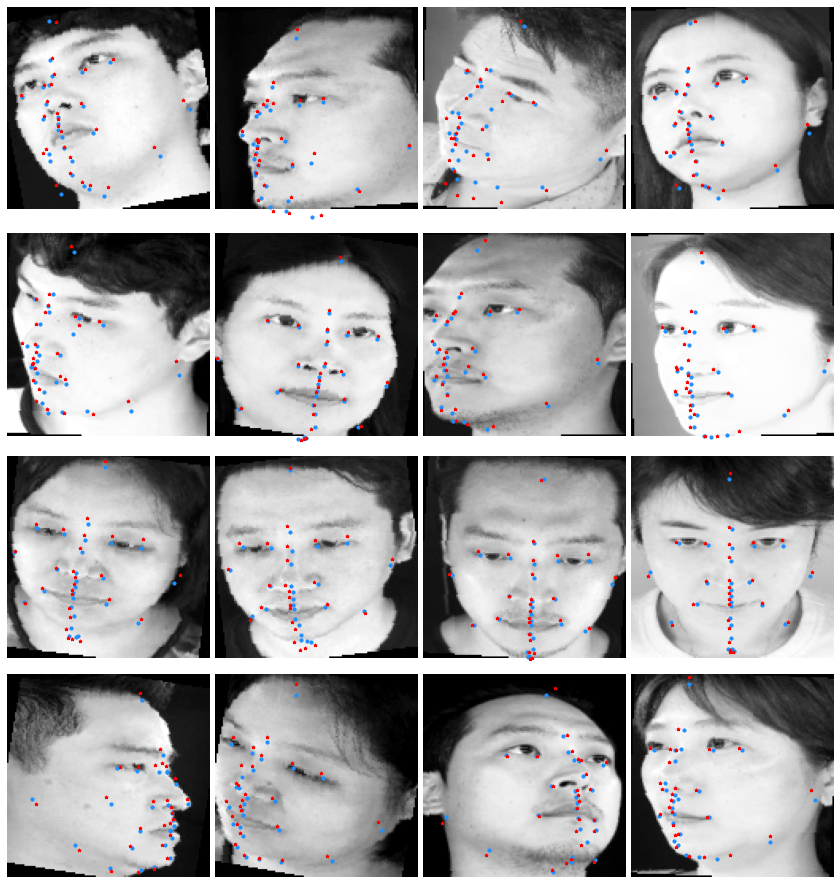

aflw nme: 0.9356 | kface nme: 0.9958
Epoch(51/100) -> Training Loss: 0.00016982 | Validation Loss: 0.00005628 | Validation nme: 0.8711


Epoch(52/100):   0%|                                                                                          …

0.00017178


Epoch(53/100):   0%|                                                                                          …

0.00016064


Epoch(54/100):   0%|                                                                                          …

0.00016365


Epoch(55/100):   0%|                                                                                          …

0.00014986


Epoch(56/100):   0%|                                                                                          …

0.00015336


Validating:   0%|                                                                                             …

Validation sample predictions


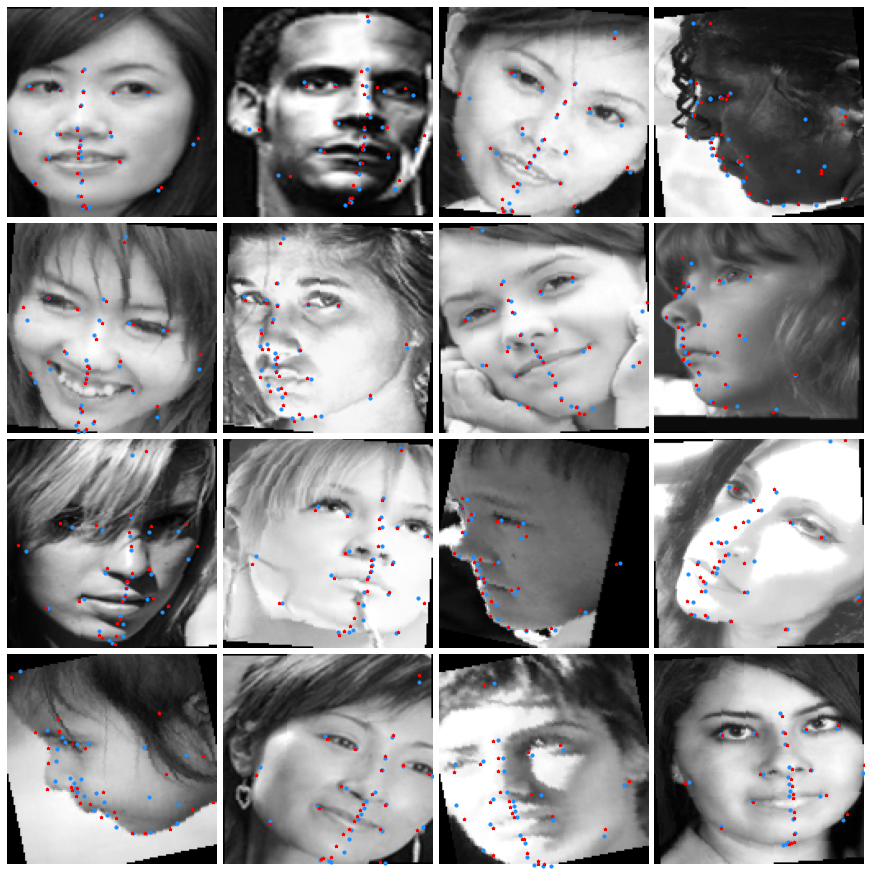

Validating:   0%|                                                                                             …

Validation sample predictions


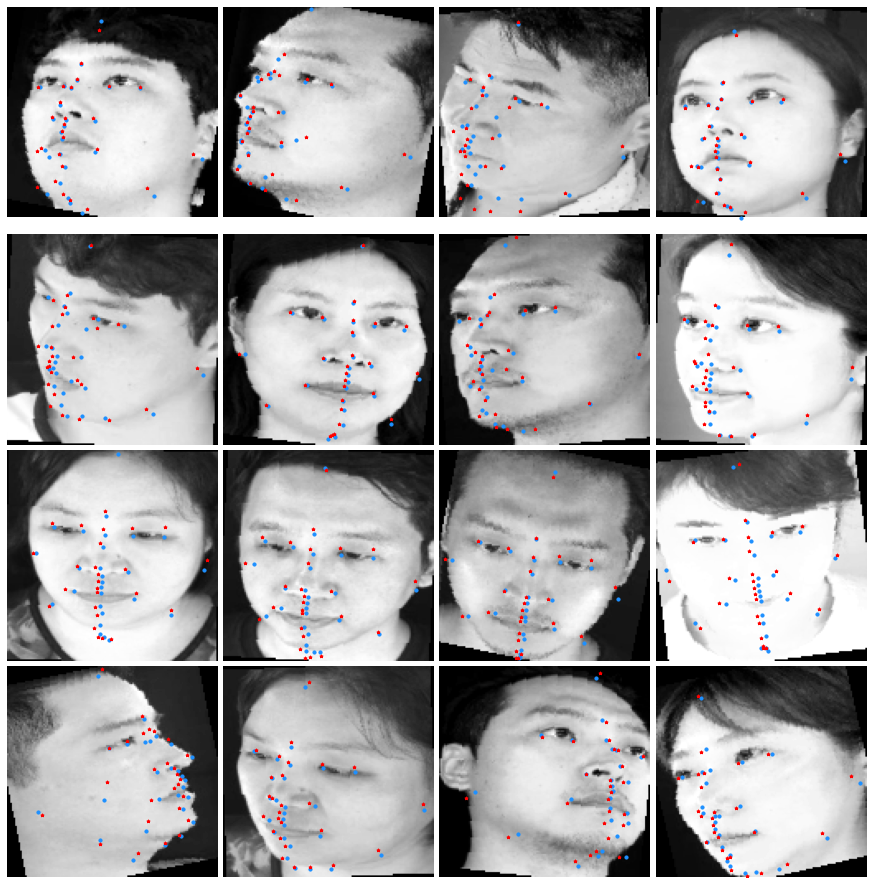

aflw nme: 1.1958 | kface nme: 0.8956
Epoch(56/100) -> Training Loss: 0.00015336 | Validation Loss: 0.00005962 | Validation nme: 0.8711


Epoch(57/100):   0%|                                                                                          …

0.00015688


Epoch(58/100):   0%|                                                                                          …

0.00015543


Epoch(59/100):   0%|                                                                                          …

0.00016734


Epoch(60/100):   0%|                                                                                          …

0.00048544


Epoch(61/100):   0%|                                                                                          …

0.00024761


Validating:   0%|                                                                                             …

Validation sample predictions


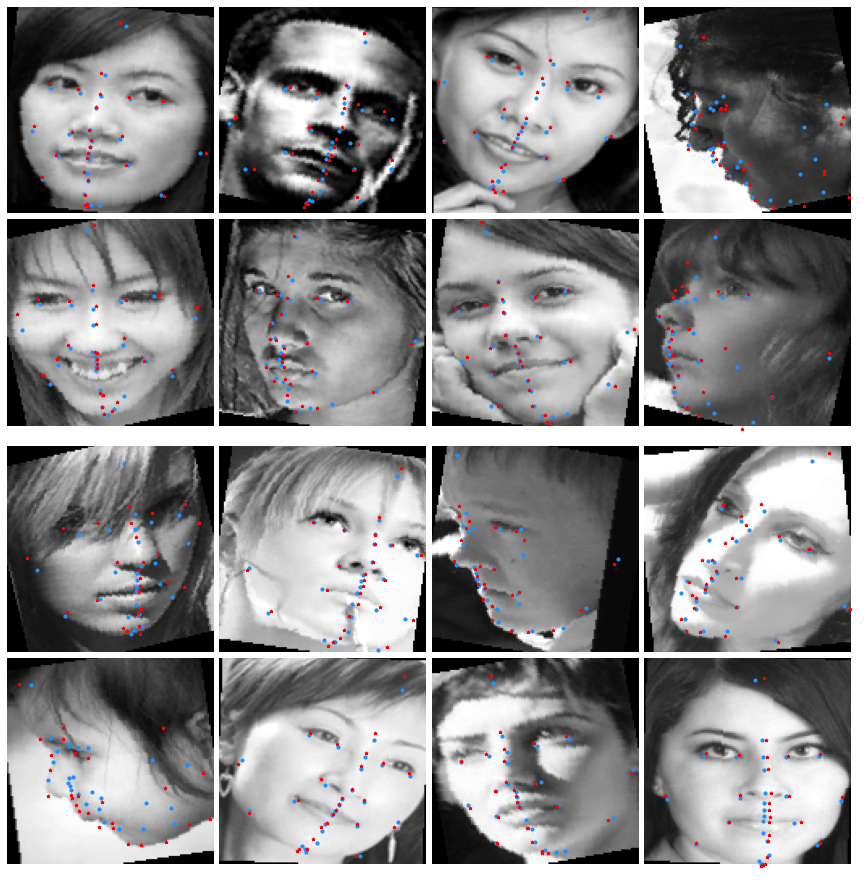

Validating:   0%|                                                                                             …

Validation sample predictions


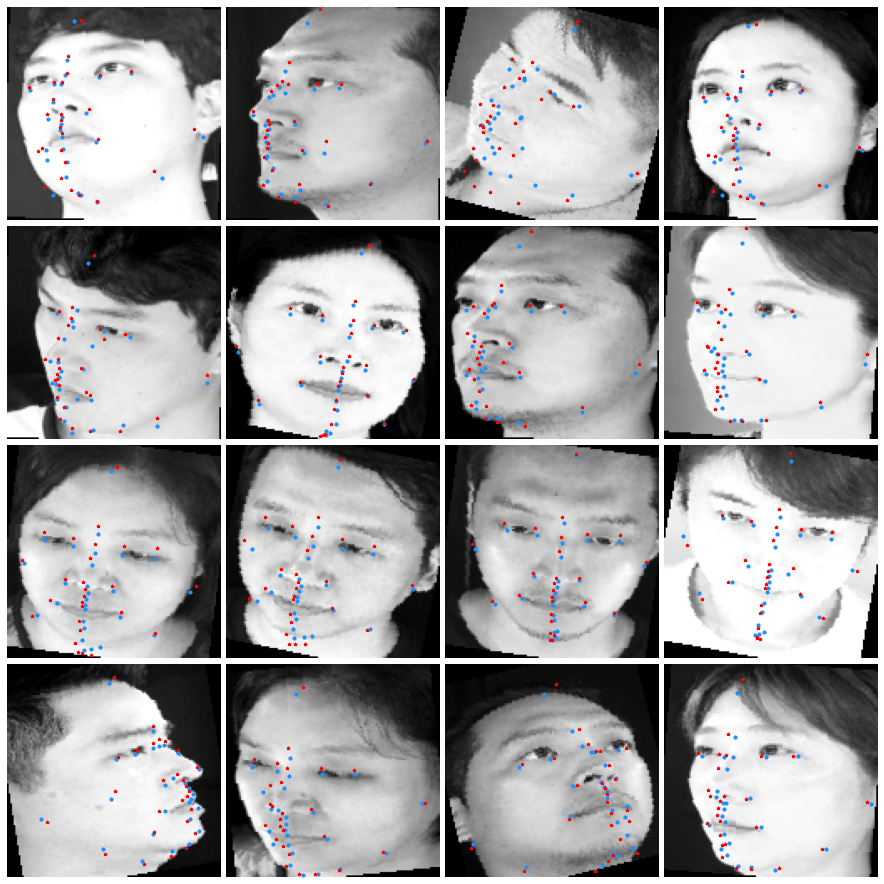

aflw nme: 1.0455 | kface nme: 1.1152
Epoch(61/100) -> Training Loss: 0.00024761 | Validation Loss: 0.00007907 | Validation nme: 0.8711


Epoch(62/100):   0%|                                                                                          …

0.00017815


Epoch(63/100):   0%|                                                                                          …

0.00016214


Epoch(64/100):   0%|                                                                                          …

0.00015828


Epoch(65/100):   0%|                                                                                          …

0.00015628


Epoch(66/100):   0%|                                                                                          …

0.00016175


Validating:   0%|                                                                                             …

Validation sample predictions


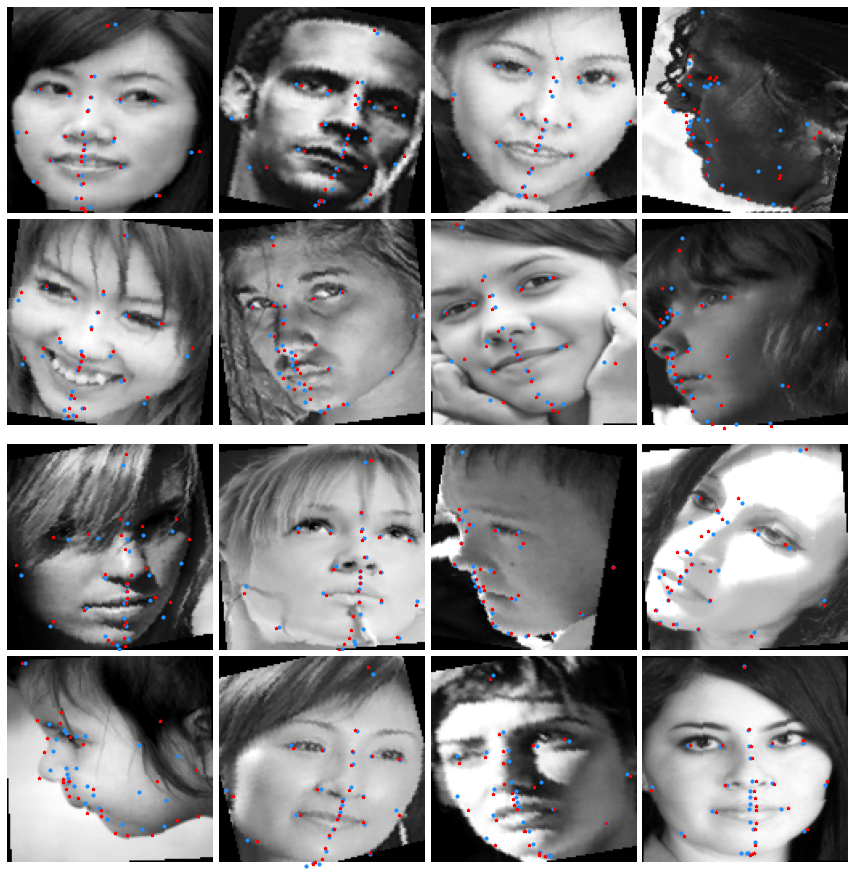

Validating:   0%|                                                                                             …

Validation sample predictions


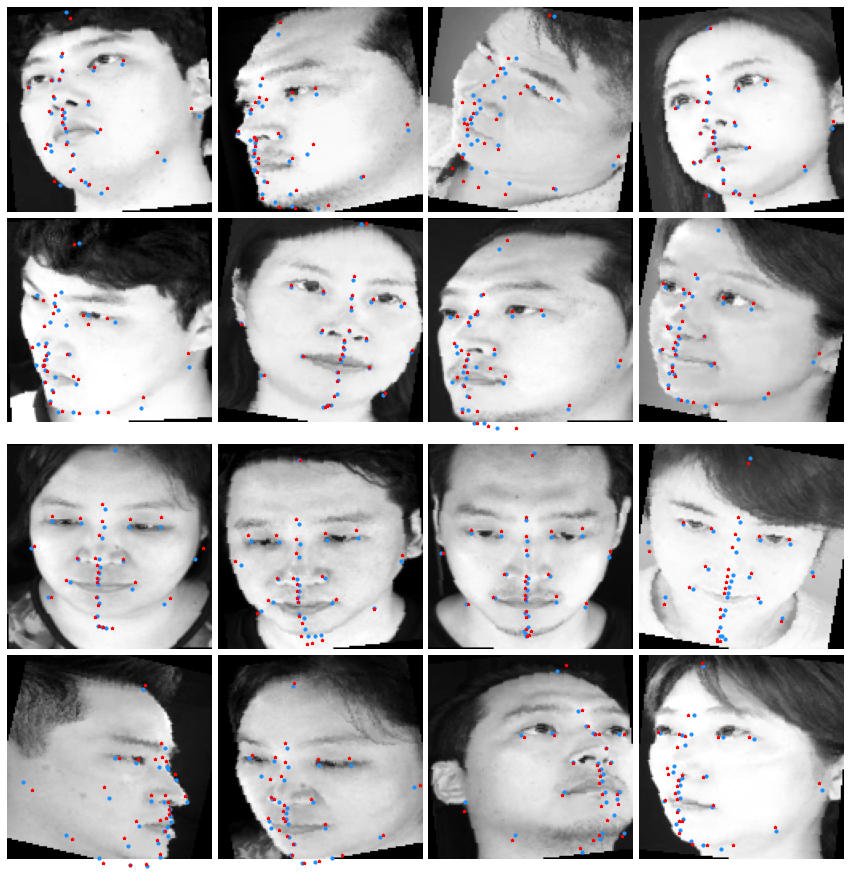

aflw nme: 0.8471 | kface nme: 0.9457
Epoch(66/100) -> Training Loss: 0.00016175 | Validation Loss: 0.00005763 | Validation nme: 0.8711


Epoch(67/100):   0%|                                                                                          …

0.00014913


Epoch(68/100):   0%|                                                                                          …

0.00015311


Epoch(69/100):   0%|                                                                                          …

0.00015554


Epoch(70/100):   0%|                                                                                          …

0.00015370


Epoch(71/100):   0%|                                                                                          …

0.00014362


Validating:   0%|                                                                                             …

Validation sample predictions


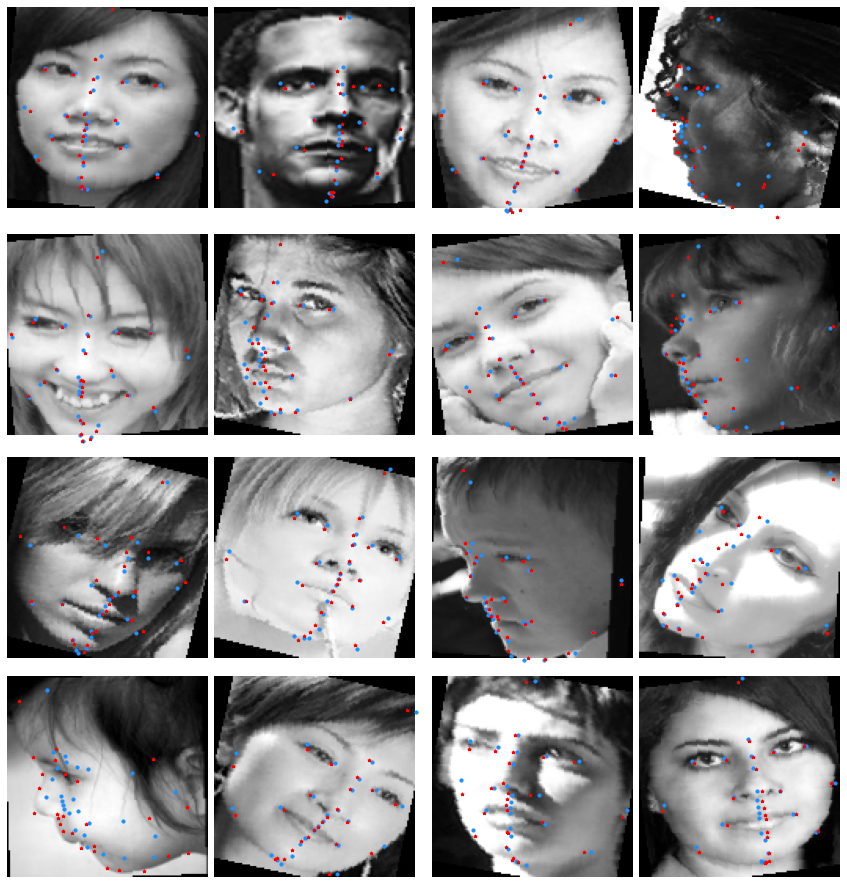

Validating:   0%|                                                                                             …

Validation sample predictions


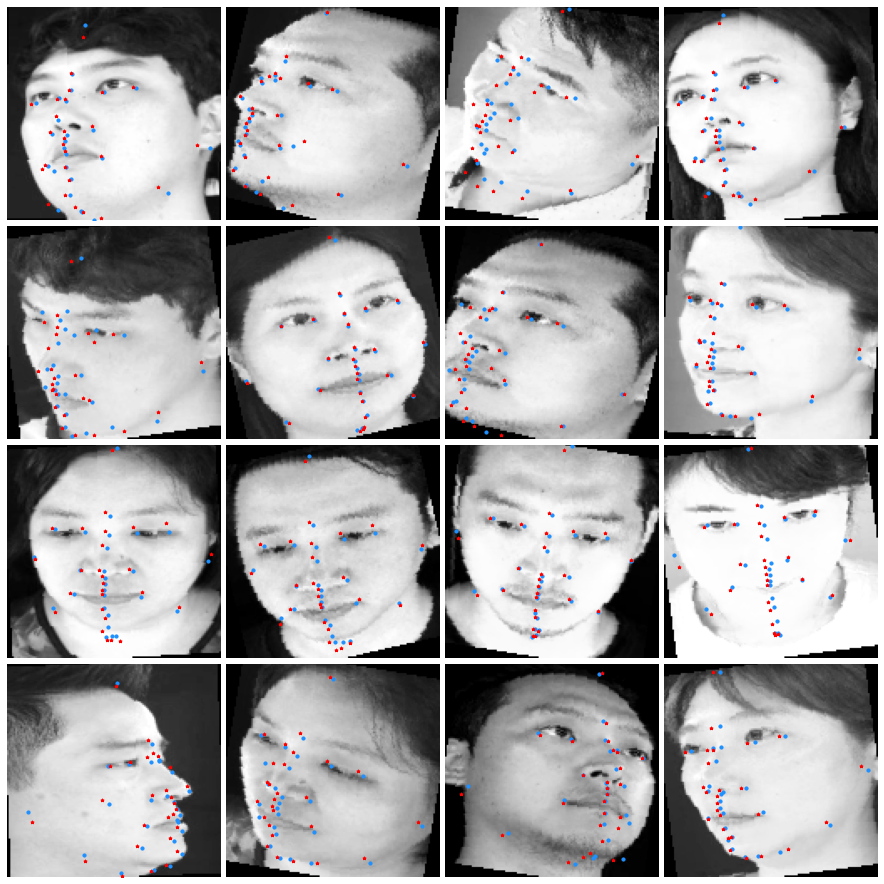

aflw nme: 1.5322 | kface nme: 0.8672
Epoch(71/100) -> Training Loss: 0.00014362 | Validation Loss: 0.00006571 | Validation nme: 0.8711


Epoch(72/100):   0%|                                                                                          …

0.00014971


Epoch(73/100):   0%|                                                                                          …

0.00016052


Epoch(74/100):   0%|                                                                                          …

0.00015097


Epoch(75/100):   0%|                                                                                          …

0.00015137


Epoch(76/100):   0%|                                                                                          …

0.00014704


Validating:   0%|                                                                                             …

Validation sample predictions


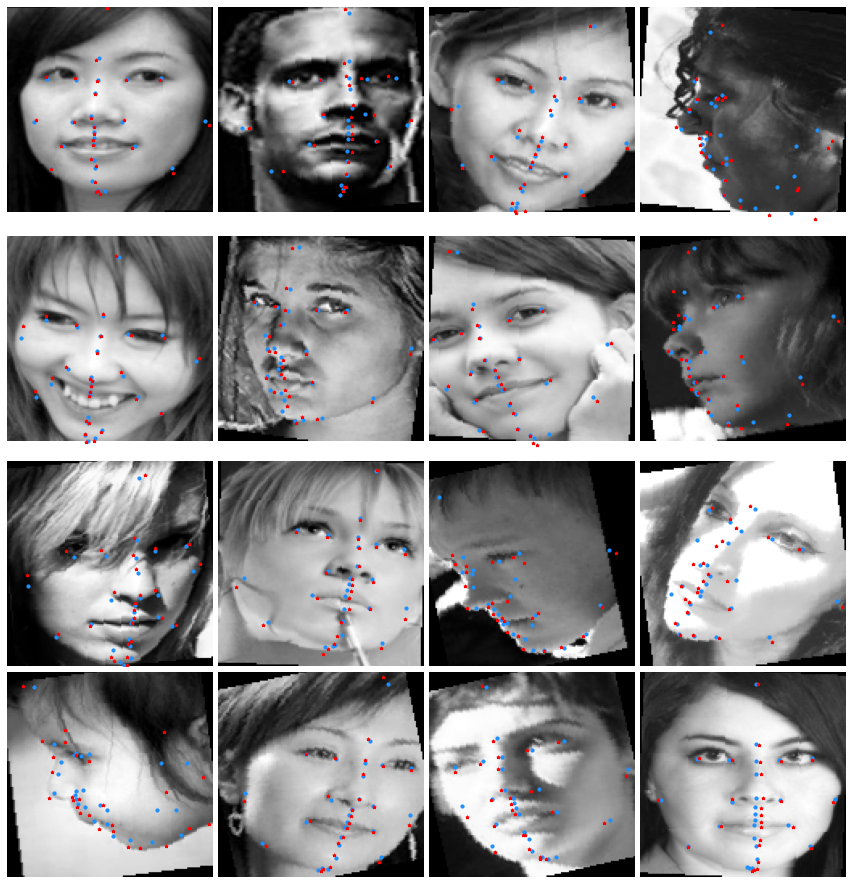

Validating:   0%|                                                                                             …

Validation sample predictions


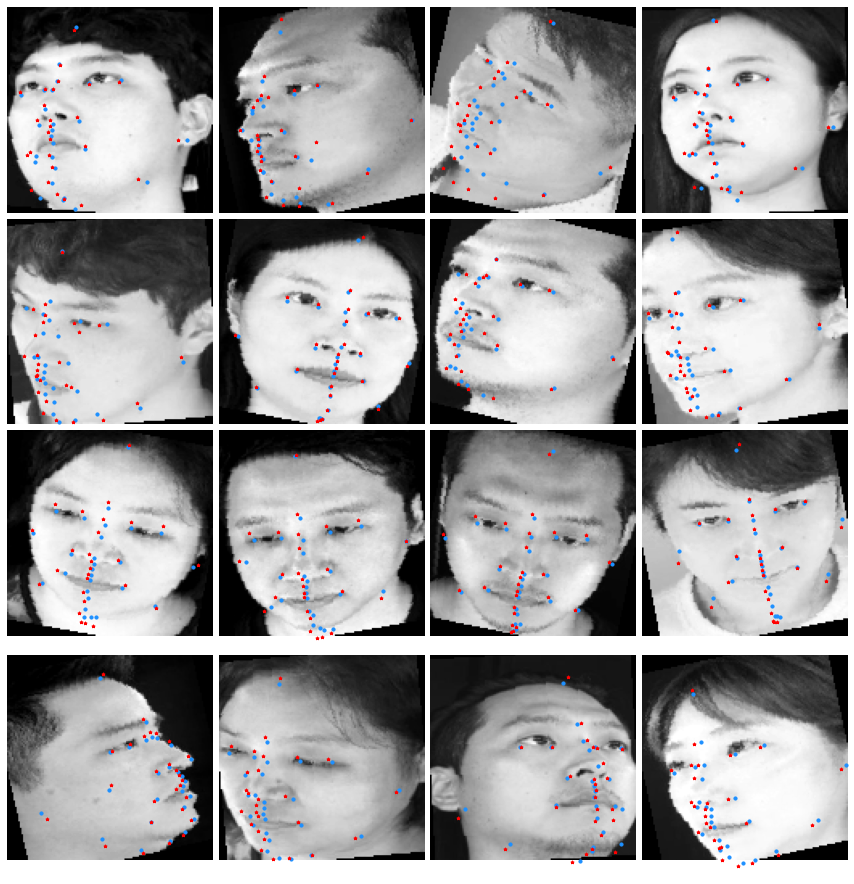

aflw nme: 0.9445 | kface nme: 1.0019
Epoch(76/100) -> Training Loss: 0.00014704 | Validation Loss: 0.00006109 | Validation nme: 0.8711


Epoch(77/100):   0%|                                                                                          …

0.00015450


Epoch(78/100):   0%|                                                                                          …

0.00015313


Epoch(79/100):   0%|                                                                                          …

0.00014530


Epoch(80/100):   0%|                                                                                          …

0.00014501


Epoch(81/100):   0%|                                                                                          …

0.00014077


Validating:   0%|                                                                                             …

Validation sample predictions


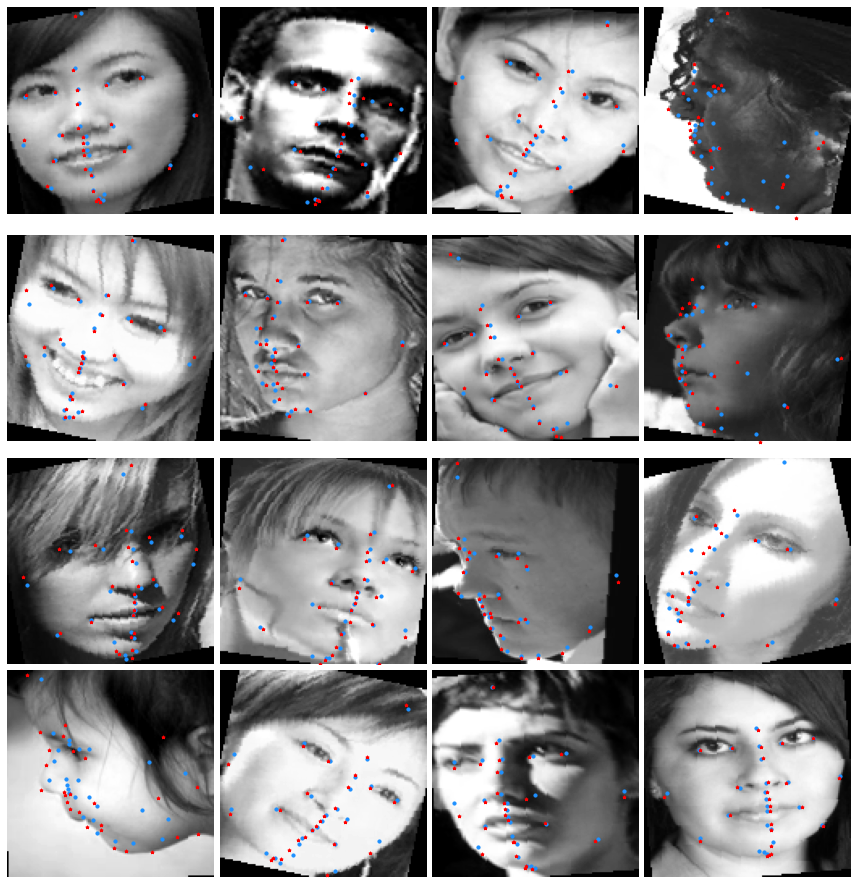

Validating:   0%|                                                                                             …

Validation sample predictions


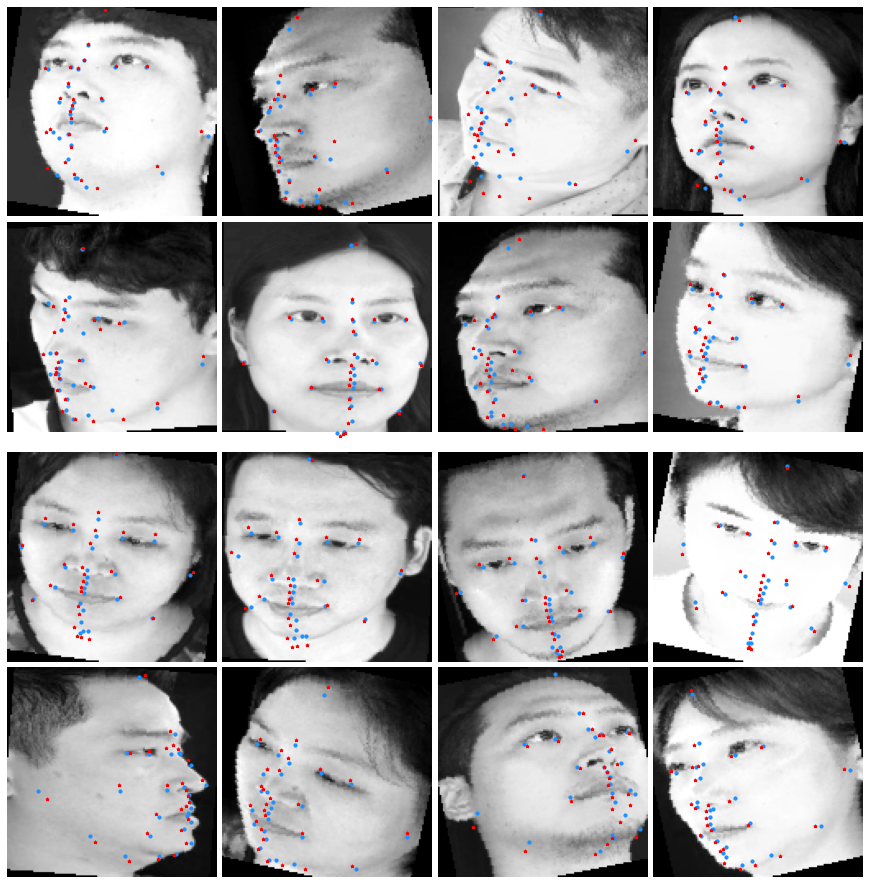

aflw nme: 0.8531 | kface nme: 1.2245
Epoch(81/100) -> Training Loss: 0.00014077 | Validation Loss: 0.00005882 | Validation nme: 0.8711


Epoch(82/100):   0%|                                                                                          …

0.00013871


Epoch(83/100):   0%|                                                                                          …

0.00015326


Epoch(84/100):   0%|                                                                                          …

0.00014046


Epoch(85/100):   0%|                                                                                          …

0.00014114


Epoch(86/100):   0%|                                                                                          …

0.00015431


Validating:   0%|                                                                                             …

Validation sample predictions


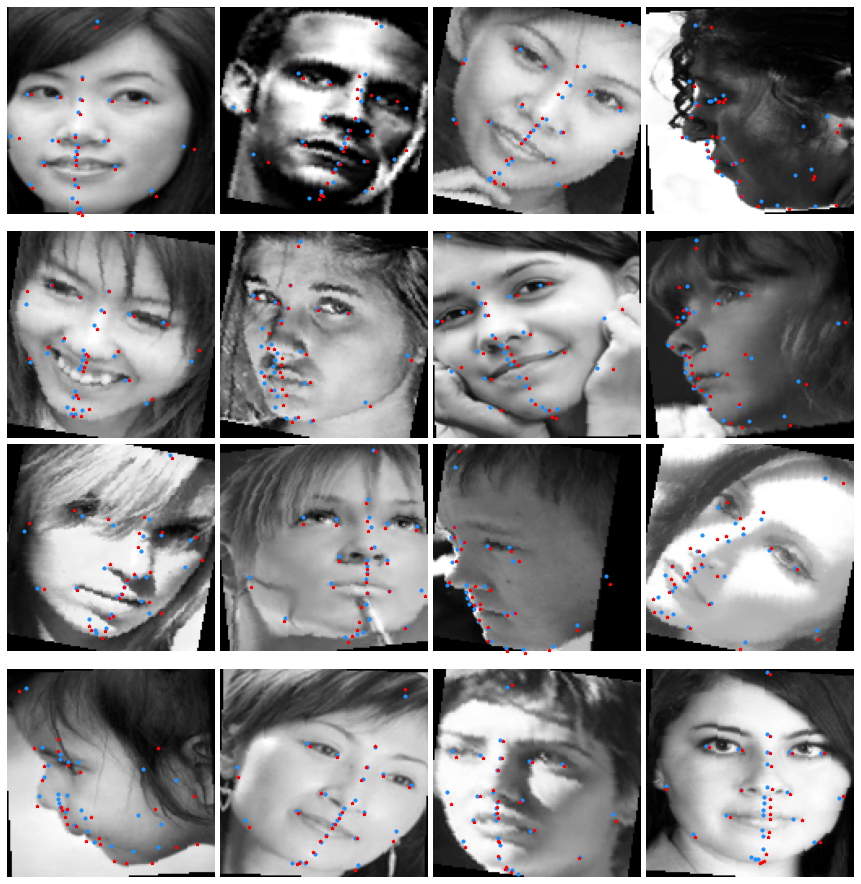

Validating:   0%|                                                                                             …

Validation sample predictions


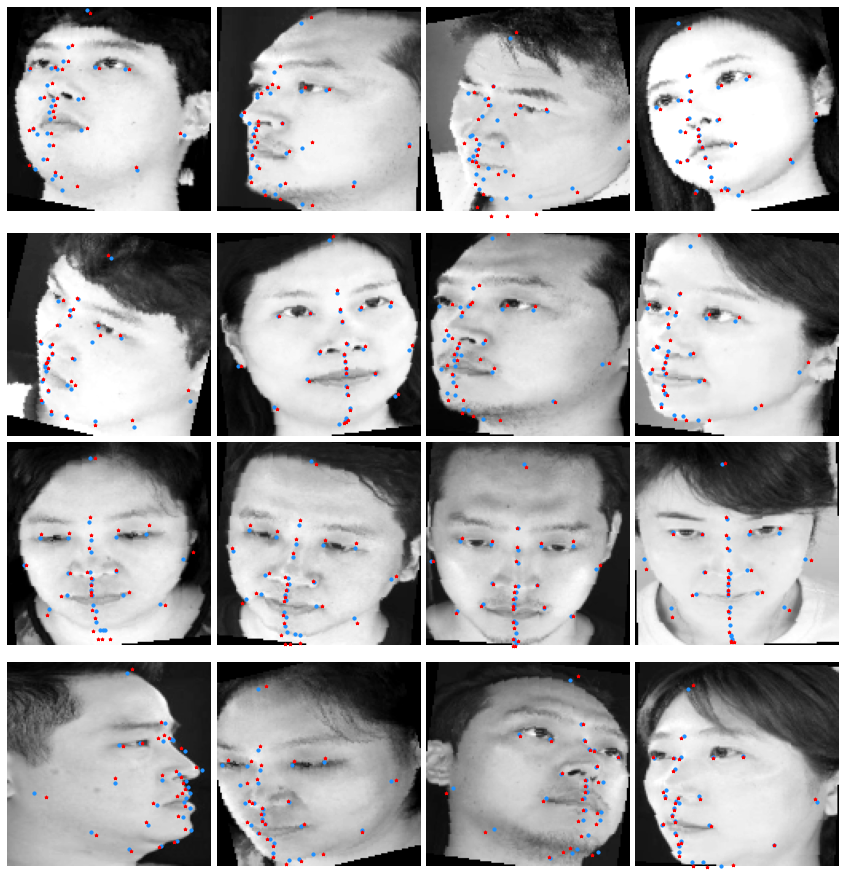

aflw nme: 1.0370 | kface nme: 1.3113
Epoch(86/100) -> Training Loss: 0.00015431 | Validation Loss: 0.00006310 | Validation nme: 0.8711


Epoch(87/100):   0%|                                                                                          …

0.00016183


Epoch(88/100):   0%|                                                                                          …

0.00014650


Epoch(89/100):   0%|                                                                                          …

0.00014771


Epoch(90/100):   0%|                                                                                          …

0.00014164


Epoch(91/100):   0%|                                                                                          …

0.00014623


Validating:   0%|                                                                                             …

Validation sample predictions


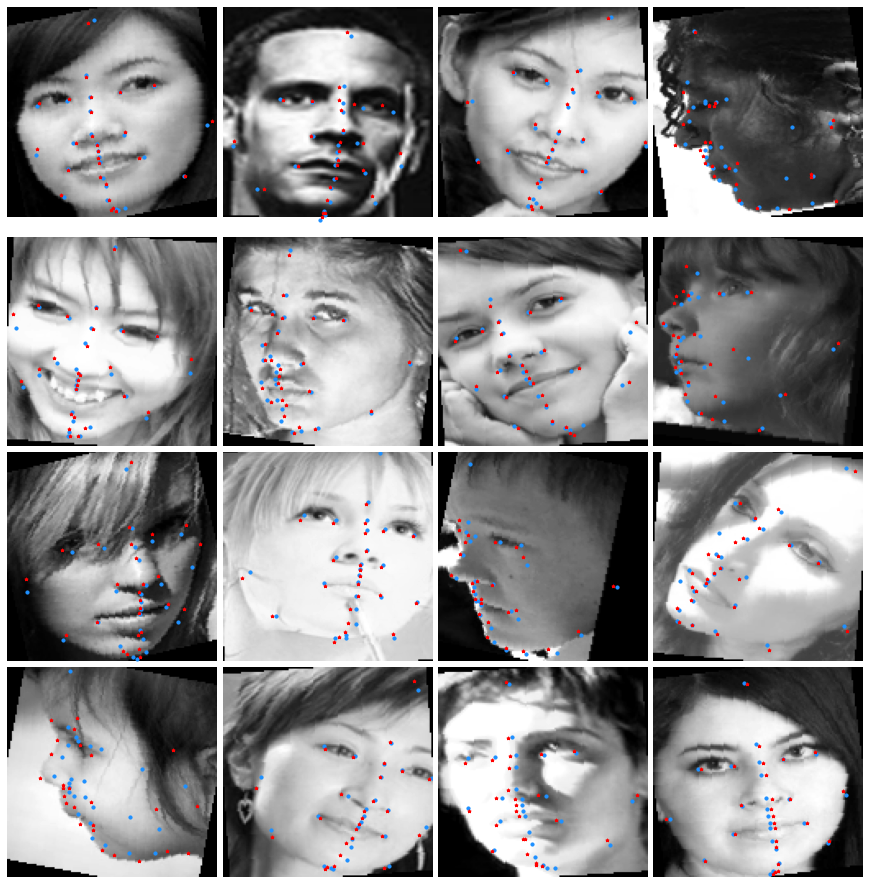

Validating:   0%|                                                                                             …

Validation sample predictions


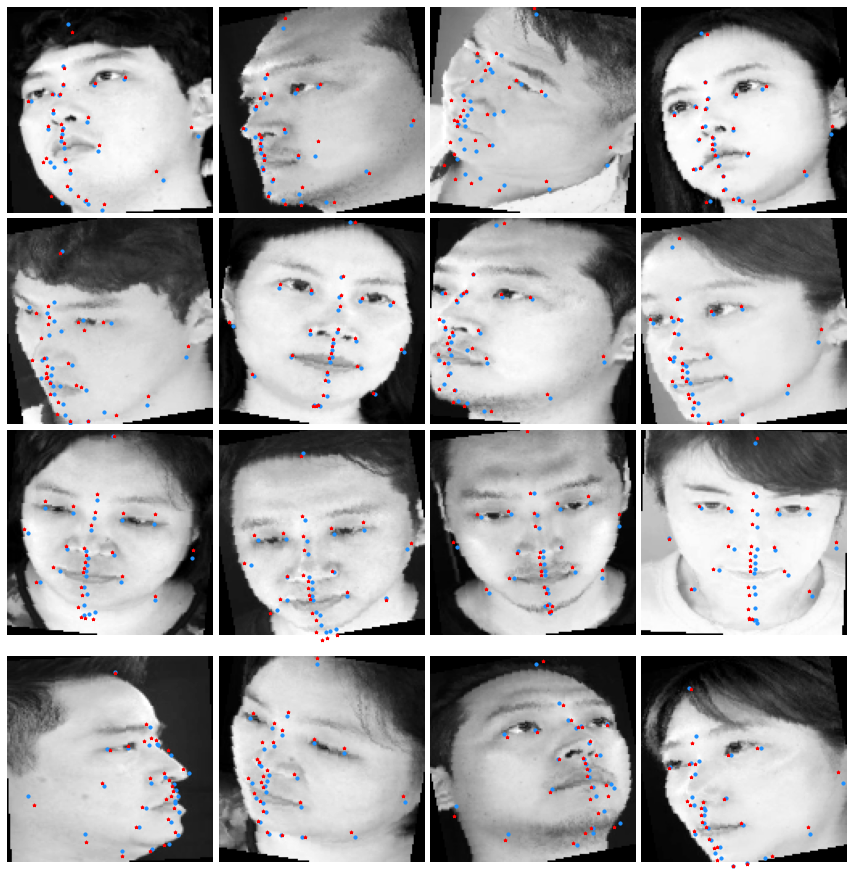

aflw nme: 0.9544 | kface nme: 1.1993
Epoch(91/100) -> Training Loss: 0.00014623 | Validation Loss: 0.00006232 | Validation nme: 0.8711


Epoch(92/100):   0%|                                                                                          …

0.00013500


Epoch(93/100):   0%|                                                                                          …

0.00014392


Epoch(94/100):   0%|                                                                                          …

0.00014350


Epoch(95/100):   0%|                                                                                          …

0.00015109


Epoch(96/100):   0%|                                                                                          …

0.00014420


Validating:   0%|                                                                                             …

Validation sample predictions


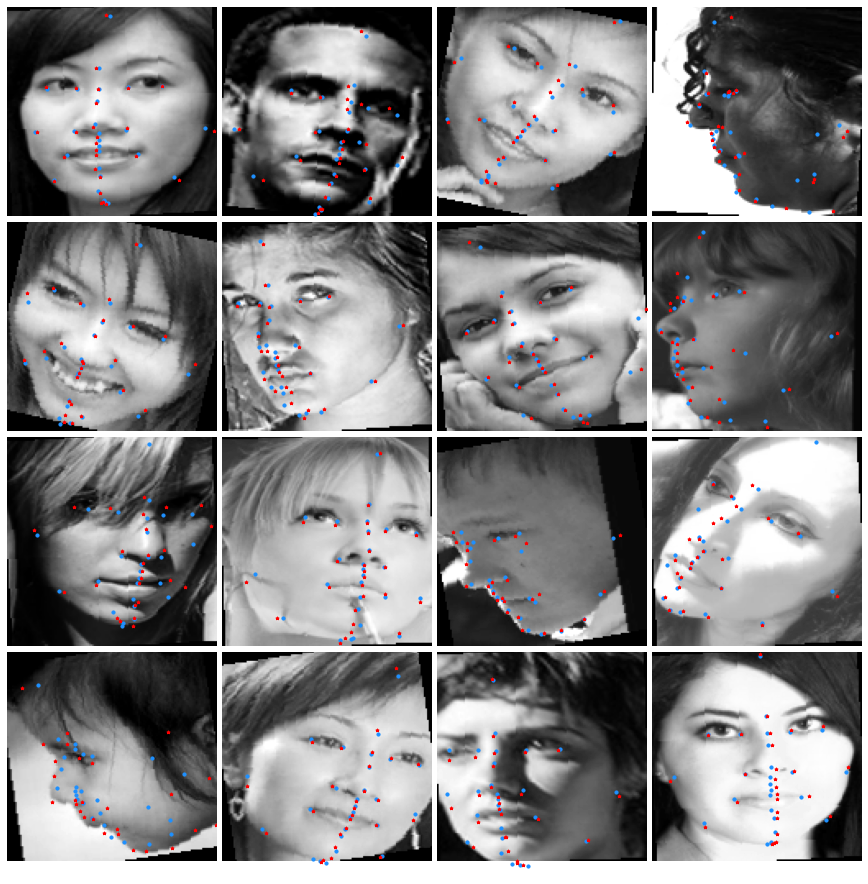

Validating:   0%|                                                                                             …

Validation sample predictions


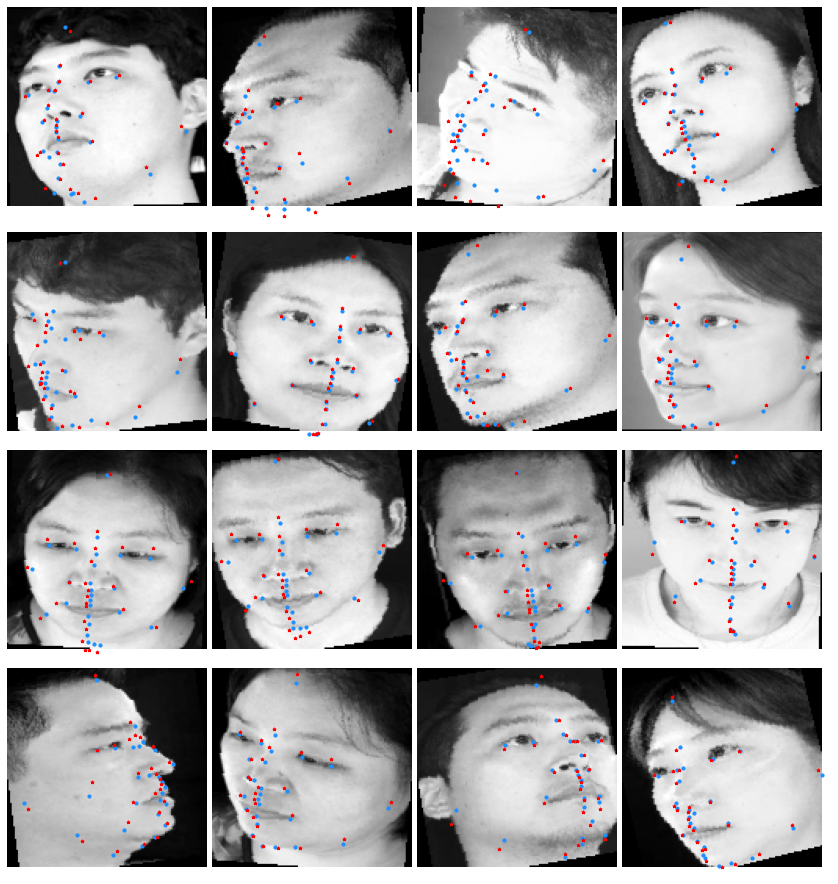

aflw nme: 0.9699 | kface nme: 0.8598
Epoch(96/100) -> Training Loss: 0.00014420 | Validation Loss: 0.00006231 | Validation nme: 0.8711


Epoch(97/100):   0%|                                                                                          …

0.00015965


Epoch(98/100):   0%|                                                                                          …

0.00014062


Epoch(99/100):   0%|                                                                                          …

0.00013778


Epoch(100/100):   0%|                                                                                         …

0.00015912


In [22]:
epochs = 100
batches = len(train_data)
best_loss = np.inf
best_nme = np.inf
optimizer.zero_grad()

for epoch in range(epochs):
    cum_loss = 0.0

    model.train()
    for batch_index, (features, labels) in enumerate(tqdm(train_data, desc = f'Epoch({epoch + 1}/{epochs})', ncols = 800)):
        features = features.cuda()
        labels = labels.cuda()

        outputs = model(features)
        
        loss = objective(outputs, labels)
        loss.backward()

        optimizer.step()
        
        optimizer.zero_grad()

        cum_loss += loss.item()
    print(f"{cum_loss/batches:.8f}")
    
    if epoch%5==0:
        val_loss_aflw, nme_aflw = validate(valid_data_aflw, os.path.join(f'/data/komedi/komedi/logs/{dates}/{cases}/image_logs/aflw', f'epoch({str(epoch + 1).zfill(len(str(epochs)))}).jpg'))
        val_loss_kfce, nme_kfce = validate(valid_data_kface, os.path.join(f'/data/komedi/komedi/logs/{dates}/{cases}/image_logs/kface', f'epoch({str(epoch + 1).zfill(len(str(epochs)))}).jpg'))
        torch.save(model.state_dict(), f'/data/komedi/komedi/logs/{dates}/{cases}/model_logs/model_{epoch}.pt')
        print(f'aflw nme: {nme_aflw:.4f} | kface nme: {nme_kfce:.4f}')
        ratio = [398/(398+387), 387/(398+387)]
        nme = nme_aflw*ratio[0]+nme_kfce*ratio[1]
        val_loss= val_loss_aflw*ratio[0]+val_loss_kfce*ratio[1]
        if nme < best_nme:
            best_nme = nme
            print('Saving model....................')
            torch.save(model.state_dict(), f'/data/komedi/komedi/logs/{dates}/{cases}/best_model_{dates}.pt')
        print(f'Epoch({epoch + 1}/{epochs}) -> Training Loss: {cum_loss/batches:.8f} | Validation Loss: {val_loss:.8f} | Validation nme: {best_nme:.4f}')